#### Get Dataset from Simulations

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import mujoco
import mujoco_viewer
import cv2,os

import sys
sys.path.append('../')
from models.utils.util import  *
from models.env.manipulator_agent import ManipulatorAgent

In [2]:
xml_path = '../asset/ur5e/scene-w-ground-prism.xml'
MODE = 'window' ################### 'window' or 'offscreen'
env = ManipulatorAgent(rel_xml_path=xml_path,VERBOSE=False, MODE=MODE)
env.close_viewer()

MODE: window


In [3]:
# Place objects
object_names = ["obj_star_green", "obj_star_red", "obj_star_blue", 
                "obj_triangle_green", "obj_triangle_red", "obj_triangle_blue"]
obj_star_names = [body_name for body_name in env.body_names
            if body_name is not None and (body_name.startswith("obj_star"))]
obj_triangle_names = [body_name for body_name in env.body_names
            if body_name is not None and (body_name.startswith("obj_triangle"))]
n_obj = 3 # len(obj_names)
xyzs = sample_xyzs(
    n_sample=n_obj*2,x_range=[0.525,1.15],y_range=[-0.38,0.38],z_range=[0.74,0.85],min_dist=0.2,xy_margin=0.1)

for obj_idx, obj_star_name, obj_triangle_name in zip(range(n_obj), obj_star_names, obj_triangle_names):
    color_idx = obj_idx % 3
    star_jntadr = env.model.body(obj_star_name).jntadr[0]
    env.model.joint(star_jntadr).qpos0[:3] = xyzs[obj_idx, :]
    triangle_jntadr = env.model.body(obj_triangle_name).jntadr[0]
    env.model.joint(triangle_jntadr).qpos0[:3] = xyzs[obj_idx+n_obj, :]

# Move tables and robot base
env.model.body('base_table').pos = np.array([0,0,0.395])
env.model.body('front_object_table').pos = np.array([0.38+0.6,0,0])
env.model.body('side_object_table').pos = np.array([-0.05,-0.80,0])
env.model.body('ur_base').pos = np.array([0.18,0,0.79])
env.model.body('ur_base').pos = np.array([0.18,0,0.8]) # robot base
for body_name in ['base_table','front_object_table','side_object_table']:
    geomadr = env.model.body(body_name).geomadr[0]
    env.model.geom(geomadr).rgba[3] = 1.0

print ("Ready.")

Ready.


#### Capture Scene

MODE: window
MODE: window


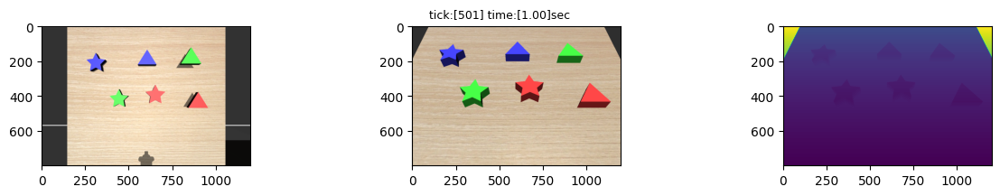

Done.


In [4]:
# Joint indices
rev_joint_names = ['shoulder_pan_joint','shoulder_lift_joint','elbow_joint',
                   'wrist_1_joint','wrist_2_joint','wrist_3_joint']
idxs_ur_fwd = env.get_idxs_fwd(joint_names=rev_joint_names)
idxs_ur_jac = env.get_idxs_jac(joint_names=rev_joint_names)
idxs_ur_step = env.get_idxs_step(joint_names=rev_joint_names)

init_pose = np.array([-1.571, -2.1916,  1.7089,  2.0533,  1.1000, -1.5706])
init_pose = np.array([-1.57077466, -2.32822577,  2.32735698,  1.57164833,  0.96625407, -1.57076883])
env.forward(q=init_pose,joint_idxs=idxs_ur_fwd)

# Place objects

object_names = ["obj_star_green", "obj_star_red", "obj_star_blue", 
                "obj_triangle_green", "obj_triangle_red", "obj_triangle_blue"]
obj_star_names = [body_name for body_name in env.body_names
            if body_name is not None and (body_name.startswith("obj_star"))]
obj_triangle_names = [body_name for body_name in env.body_names
            if body_name is not None and (body_name.startswith("obj_triangle"))]
n_obj = 3 # len(obj_names)
xyzs = sample_xyzs(
    n_sample=n_obj*2,x_range=[0.525,1.15],y_range=[-0.38,0.38],z_range=[0.74,0.85],min_dist=0.2,xy_margin=0.1)

for obj_idx, obj_star_name, obj_triangle_name in zip(range(n_obj), obj_star_names, obj_triangle_names):
    color_idx = obj_idx % 3
    star_jntadr = env.model.body(obj_star_name).jntadr[0]
    env.model.joint(star_jntadr).qpos0[:3] = xyzs[obj_idx, :]
    triangle_jntadr = env.model.body(obj_triangle_name).jntadr[0]
    env.model.joint(triangle_jntadr).qpos0[:3] = xyzs[obj_idx+n_obj, :]

env.reset()
env.forward(q=init_pose,joint_idxs=idxs_ur_fwd)
env.set_viewer()
env.update_viewer(azimuth=0,distance=0.5,elevation=-90,lookat=[0.8,0.0,1.2],
                VIS_TRANSPARENT=False,VIS_CONTACTPOINT=False,
                contactwidth=0.05,contactheight=0.05,contactrgba=np.array([1,0,0,1]),
                VIS_JOINT=False,jointlength=0.5,jointwidth=0.1,
                jointrgba=[0.2,0.6,0.8,0.6])

FIRST_FLAG = True
while env.is_viewer_alive():
    # Step
    env.step(ctrl=np.append(init_pose,1.0),ctrl_idxs=idxs_ur_step+[6])
    
    # Render
    if env.loop_every(HZ=1) and env.get_sim_time() >= 1.0:
        fig,axs = plt.subplots(1,3,figsize=(15,2))
        scene_img,rgb_img,depth_img = env.get_image_both_mode(body_name='ur_camera_center')
        axs[0].imshow(scene_img); axs[1].imshow(rgb_img); axs[2].imshow(depth_img)
        fig.suptitle('tick:[%d] time:[%.2f]sec'%(env.tick,env.get_sim_time()),fontsize=9)
        plt.subplots_adjust(wspace=0.2); plt.show()
        break

    # Clear flag
    FIRST_FLAG = False
env.close_viewer()
print ("Done.")

#### Move object with each preference objective: `Color, Shape, Stack`

In [5]:
def save_img(scene_img, rgb_img, img_idx, save_path):
    if not os.path.exists(save_path):
        os.makedirs(save_path)
    print(save_path+f'scene_img_{img_idx}.png')
    plt.imsave(save_path+f'scene_img_{img_idx}.png',scene_img)
    plt.imsave(save_path+f'rgb_img_{img_idx}.png',rgb_img)

In [6]:
def random_sample_object(env):
    # Place objects
    obj_star_names = [body_name for body_name in env.body_names
                if body_name is not None and (body_name.startswith("obj_star"))]
    obj_triangle_names = [body_name for body_name in env.body_names
                if body_name is not None and (body_name.startswith("obj_triangle"))]
    n_obj = 3 # len(obj_names)
    xyzs_star = sample_xyzs(
        n_sample=n_obj,x_range=[0.6,1.05],y_range=[-0.35,0.35],z_range=[0.74,0.80],min_dist=0.2,xy_margin=0.1)
        # n_sample=n_obj,x_range=[0.725,0.725],y_range=[-0.15,-0.15],z_range=[0.74,1.00],min_dist=0.0,xy_margin=0.0)
    xyzs_triangle = sample_xyzs(
        n_sample=n_obj,x_range=[0.6,1.05],y_range=[-0.35,0.35],z_range=[0.74,0.80],min_dist=0.15,xy_margin=0.05)
        # n_sample=n_obj,x_range=[0.725,0.725],y_range=[0.15,0.15],z_range=[0.74,1.00],min_dist=0.0,xy_margin=0.0)

    for obj_idx, obj_star_name, obj_triangle_name in zip(range(n_obj), obj_star_names, obj_triangle_names):
        star_jntadr = env.model.body(obj_star_name).jntadr[0]
        env.model.joint(star_jntadr).qpos0[:3] = xyzs_star[obj_idx, :]
        triangle_jntadr = env.model.body(obj_triangle_name).jntadr[0]
        env.model.joint(triangle_jntadr).qpos0[:3] = xyzs_triangle[obj_idx, :]

In [7]:
def parse_color_shape(obj_name):
    """
        Parse color and shape from object name
    """
    parts = obj_name.split('_')
    return parts[2], parts[1]  # (color, shape)

def get_object_positions(env, object_names):
    positions = {}
    for obj in object_names:
        positions[obj] = env.get_p_body(obj)
    return positions

def calculate_distance(pos1, pos2):
    return np.linalg.norm(np.array(pos1) - np.array(pos2))

object_positions = get_object_positions(env, object_names)

max_distance = 0
max_pair = (None, None)
for star in [obj for obj in object_names if 'star' in obj]:
    for triangle in [obj for obj in object_names if 'triangle' in obj]:
        distance = calculate_distance(object_positions[star], object_positions[triangle])
        if distance > max_distance:
            max_distance = distance
            max_pair = (star, triangle)
max_pair

('obj_star_blue', 'obj_triangle_red')

MODE: window
MODE: window


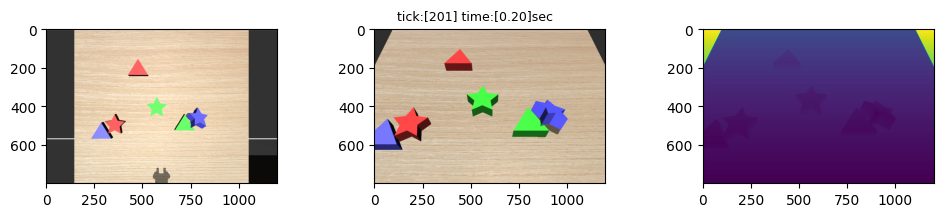

./prism/shape/1/scene_img_0.png
Moved object `obj_star_green` to ['0.758', '-0.274', '0.859']
move obj_star_green to obj_star_blue


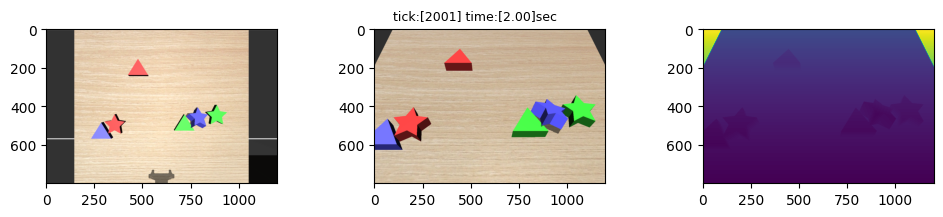

./prism/shape/1/scene_img_1.png
Moved object `obj_star_red` to ['0.645', '-0.075', '0.858']
move obj_star_red to obj_star_blue


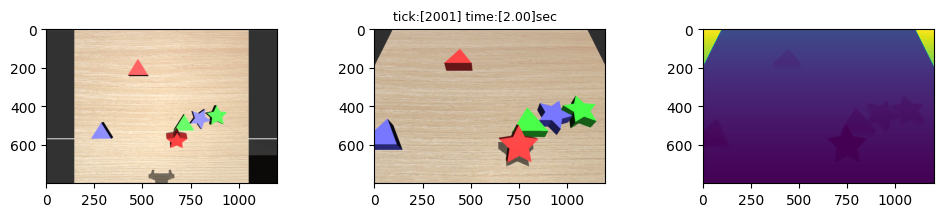

./prism/shape/1/scene_img_2.png
Moved object `obj_triangle_green` to ['0.700', '0.436', '0.840']
move obj_triangle_green to obj_triangle_blue


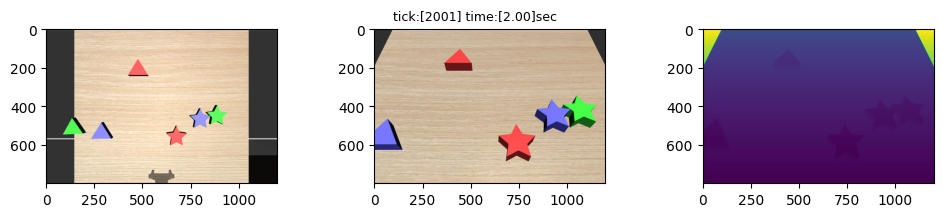

./prism/shape/1/scene_img_3.png
Moved object `obj_triangle_red` to ['0.810', '0.310', '0.840']
move obj_triangle_red to obj_triangle_blue


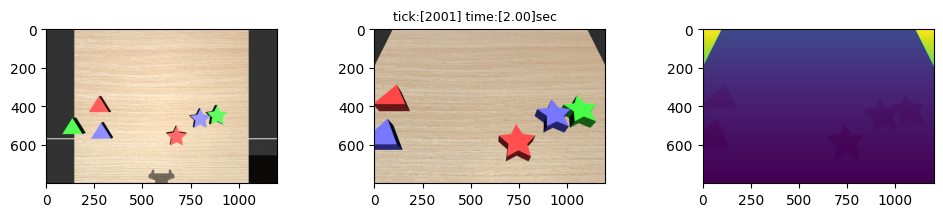

./prism/shape/1/scene_img_4.png
MODE: window
MODE: window


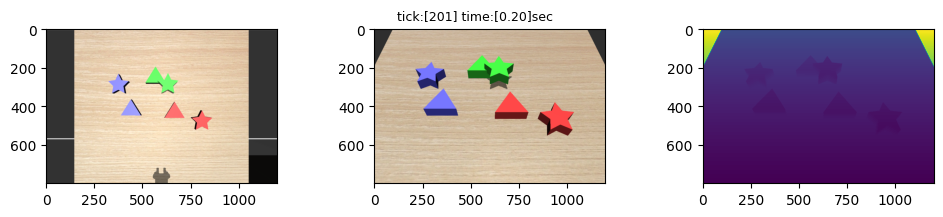

./prism/shape/2/scene_img_0.png
Moved object `obj_star_green` to ['0.721', '-0.079', '0.839']
move obj_star_green to obj_star_red


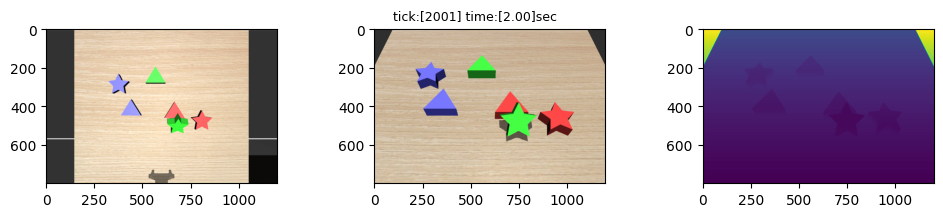

./prism/shape/2/scene_img_1.png
Moved object `obj_star_blue` to ['0.799', '-0.314', '0.840']
move obj_star_blue to obj_star_red


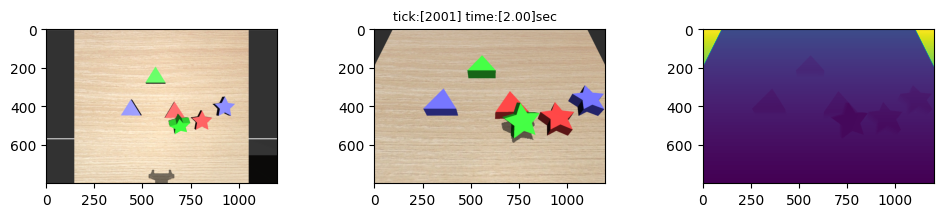

./prism/shape/2/scene_img_2.png
Moved object `obj_triangle_green` to ['0.889', '0.042', '0.840']
move obj_triangle_green to obj_triangle_blue


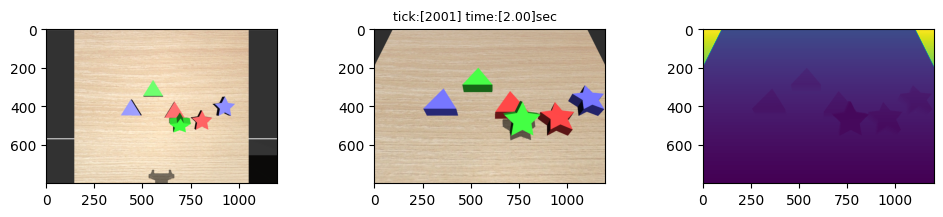

./prism/shape/2/scene_img_3.png
Moved object `obj_triangle_red` to ['0.700', '0.268', '0.840']
move obj_triangle_red to obj_triangle_blue


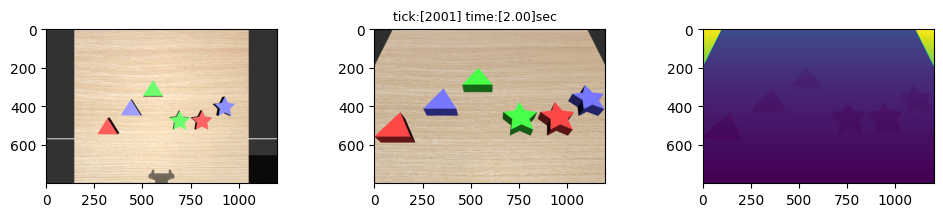

./prism/shape/2/scene_img_4.png
MODE: window
MODE: window


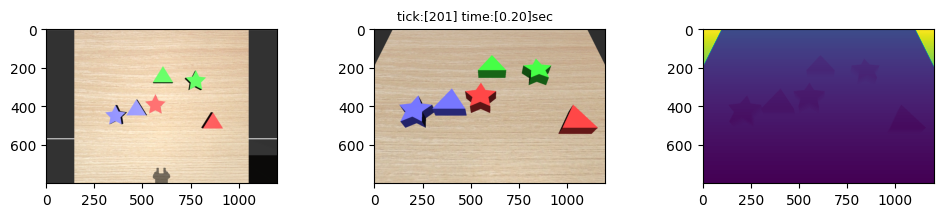

./prism/shape/3/scene_img_0.png
Moved object `obj_triangle_green` to ['0.843', '-0.311', '0.840']
move obj_triangle_green to obj_triangle_red


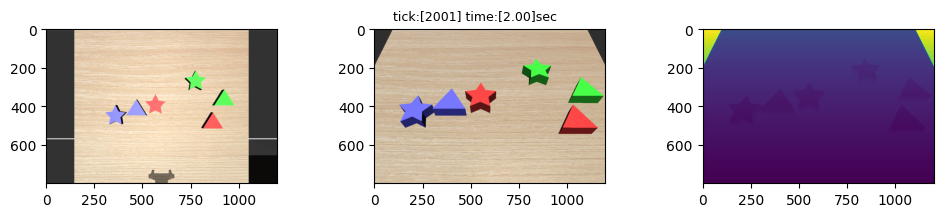

./prism/shape/3/scene_img_1.png
Moved object `obj_triangle_blue` to ['0.818', '-0.123', '0.840']
move obj_triangle_blue to obj_triangle_red


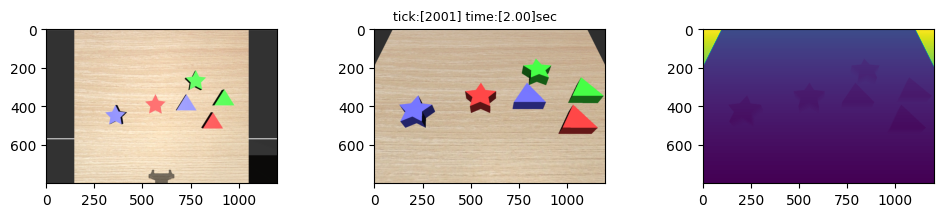

./prism/shape/3/scene_img_2.png
Moved object `obj_star_green` to ['0.634', '0.219', '0.840']
move obj_star_green to obj_star_blue


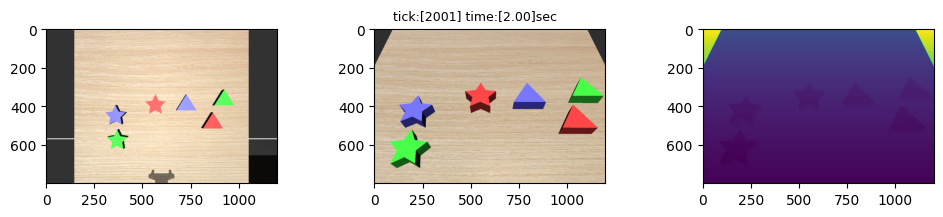

./prism/shape/3/scene_img_3.png
Moved object `obj_star_red` to ['0.827', '0.143', '0.840']
move obj_star_red to obj_star_blue


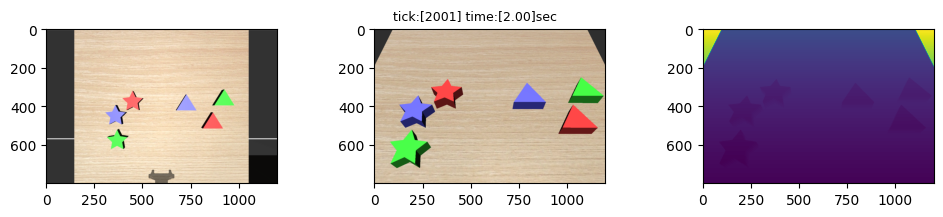

./prism/shape/3/scene_img_4.png
MODE: window
MODE: window


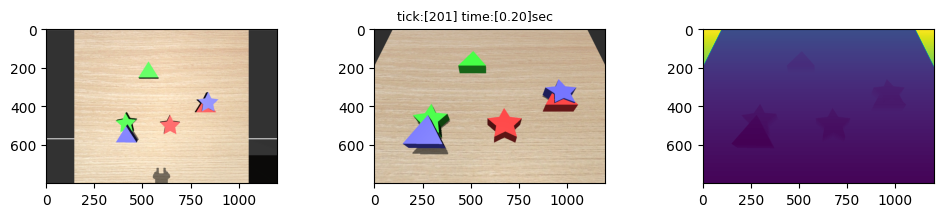

./prism/shape/4/scene_img_0.png
Moved object `obj_star_green` to ['0.800', '-0.111', '0.845']
move obj_star_green to obj_star_blue


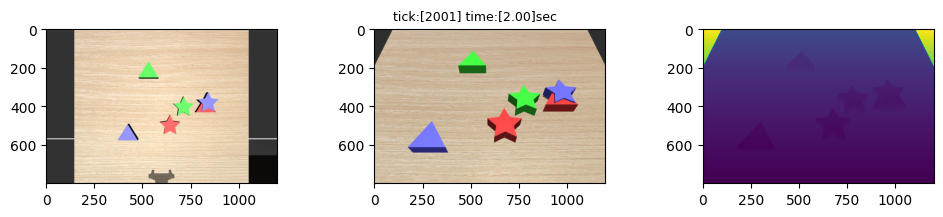

./prism/shape/4/scene_img_1.png
Moved object `obj_star_red` to ['0.702', '-0.173', '0.846']
move obj_star_red to obj_star_blue


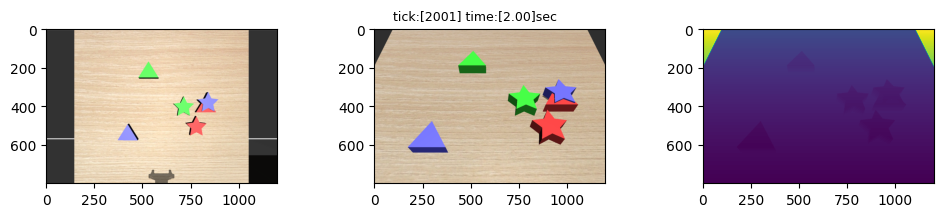

./prism/shape/4/scene_img_2.png
Moved object `obj_triangle_green` to ['0.586', '0.105', '0.840']
move obj_triangle_green to obj_triangle_blue


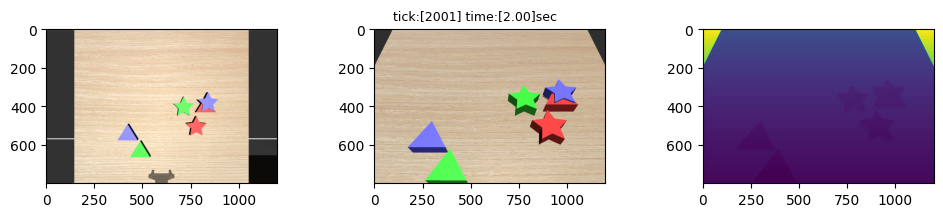

./prism/shape/4/scene_img_3.png
Moved object `obj_triangle_red` to ['0.743', '0.086', '0.840']
move obj_triangle_red to obj_triangle_blue


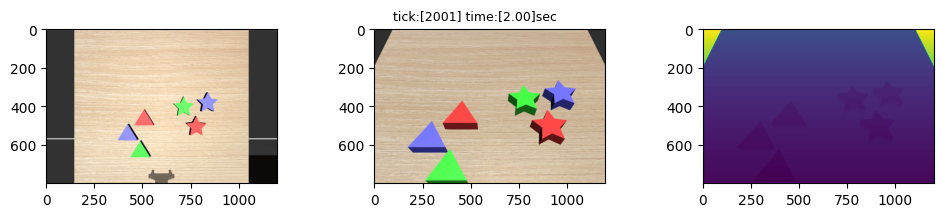

./prism/shape/4/scene_img_4.png
MODE: window
MODE: window


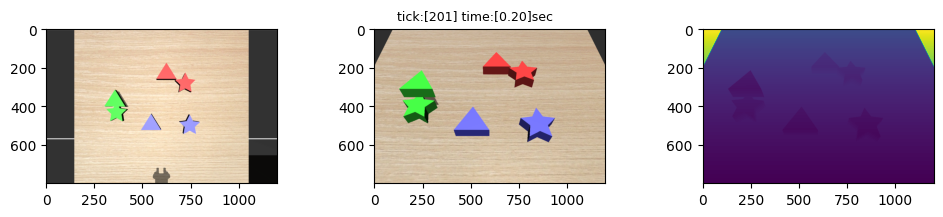

./prism/shape/5/scene_img_0.png
Moved object `obj_star_green` to ['0.793', '-0.202', '0.840']
move obj_star_green to obj_star_blue


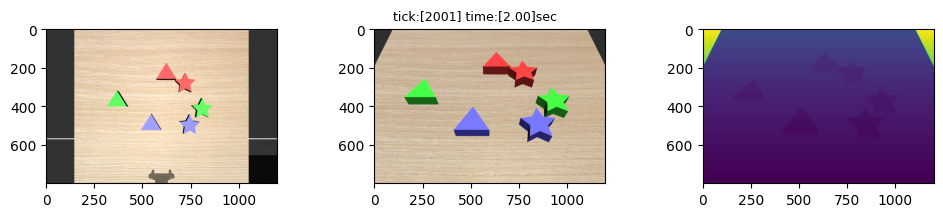

./prism/shape/5/scene_img_1.png
Moved object `obj_star_red` to ['0.587', '-0.108', '0.840']
move obj_star_red to obj_star_blue


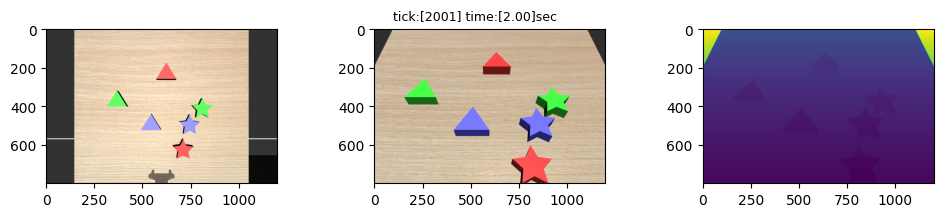

./prism/shape/5/scene_img_2.png
Moved object `obj_triangle_red` to ['0.887', '0.341', '0.840']
move obj_triangle_red to obj_triangle_green


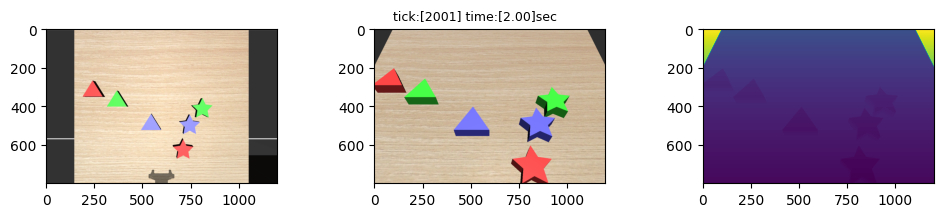

./prism/shape/5/scene_img_3.png
Moved object `obj_triangle_blue` to ['0.713', '0.303', '0.840']
move obj_triangle_blue to obj_triangle_green


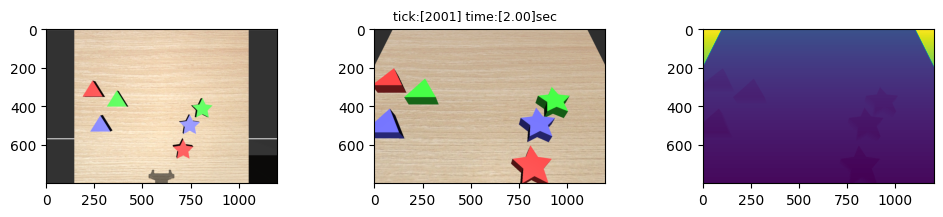

./prism/shape/5/scene_img_4.png
MODE: window
MODE: window


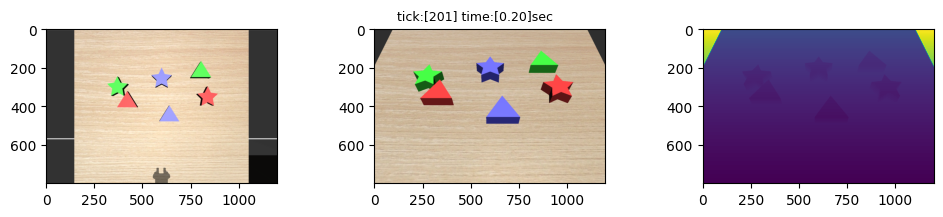

./prism/shape/6/scene_img_0.png
Moved object `obj_triangle_red` to ['1.083', '-0.273', '0.840']
move obj_triangle_red to obj_triangle_green


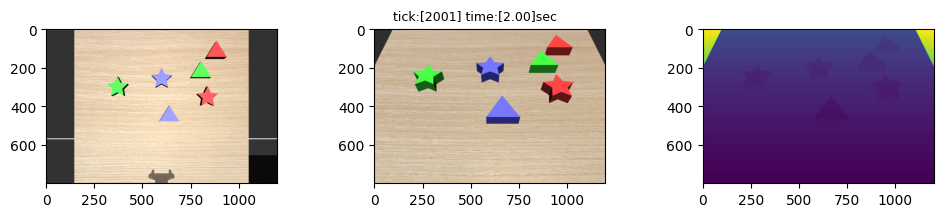

./prism/shape/6/scene_img_1.png
Moved object `obj_triangle_blue` to ['0.872', '-0.151', '0.840']
move obj_triangle_blue to obj_triangle_green


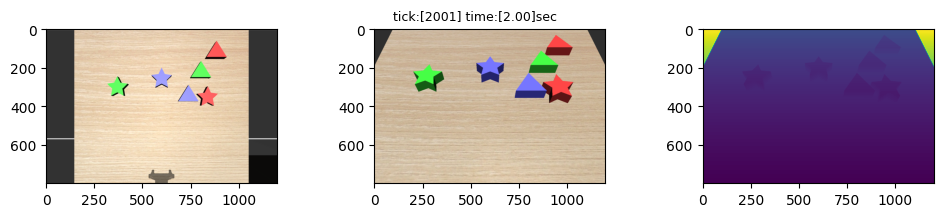

./prism/shape/6/scene_img_2.png
Moved object `obj_star_red` to ['0.995', '0.247', '0.840']
move obj_star_red to obj_star_green


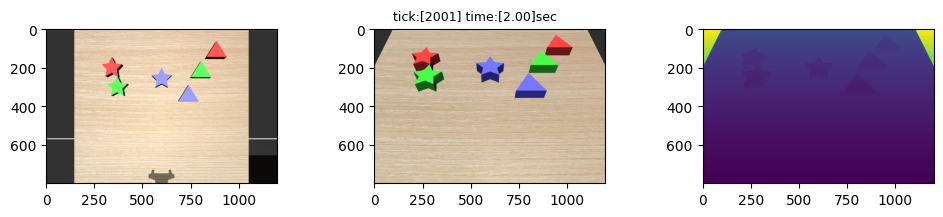

./prism/shape/6/scene_img_3.png
Moved object `obj_star_blue` to ['0.941', '0.118', '0.840']
move obj_star_blue to obj_star_green


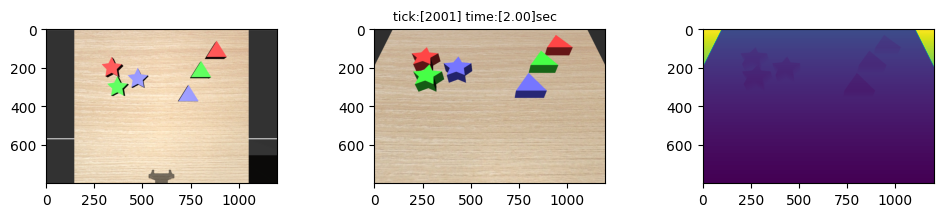

./prism/shape/6/scene_img_4.png
MODE: window
MODE: window


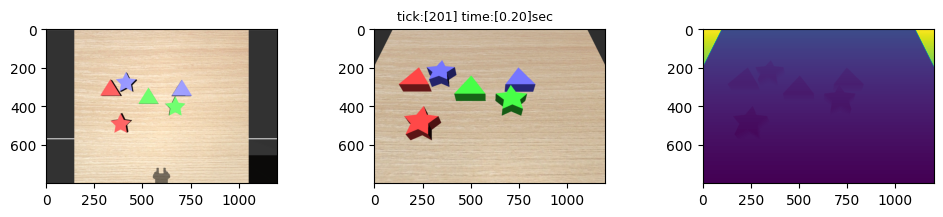

./prism/shape/7/scene_img_0.png
Moved object `obj_star_green` to ['0.796', '0.263', '0.840']
move obj_star_green to obj_star_red


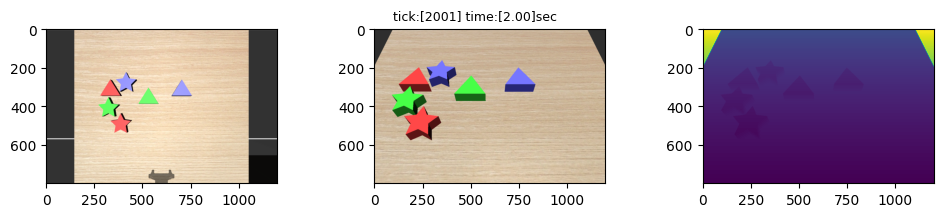

./prism/shape/7/scene_img_1.png
Moved object `obj_star_blue` to ['0.610', '0.206', '0.840']
move obj_star_blue to obj_star_red


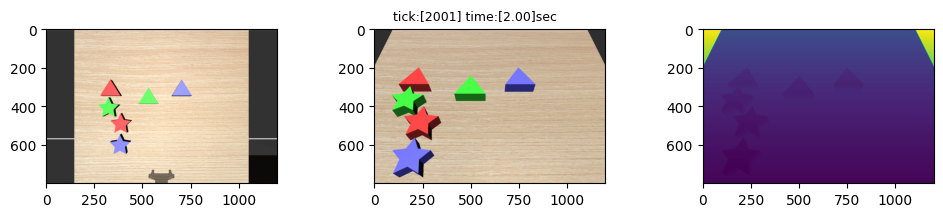

./prism/shape/7/scene_img_2.png
Moved object `obj_triangle_green` to ['0.843', '0.051', '0.840']
move obj_triangle_green to obj_triangle_blue


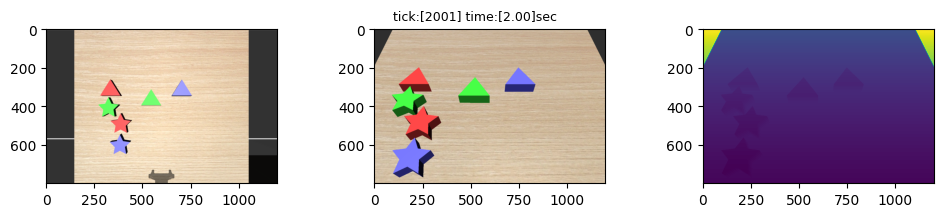

./prism/shape/7/scene_img_3.png
Moved object `obj_triangle_red` to ['0.903', '-0.248', '0.840']
move obj_triangle_red to obj_triangle_blue


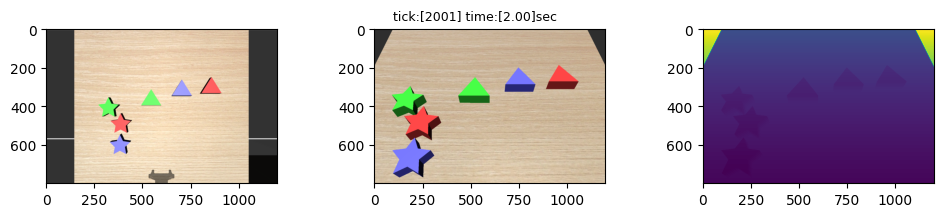

./prism/shape/7/scene_img_4.png
MODE: window
MODE: window


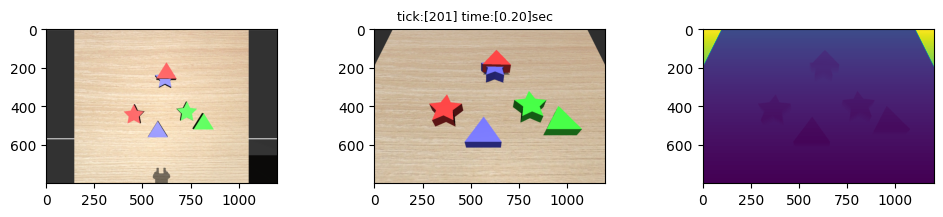

./prism/shape/8/scene_img_0.png
Moved object `obj_triangle_red` to ['0.573', '-0.163', '0.839']
move obj_triangle_red to obj_triangle_green


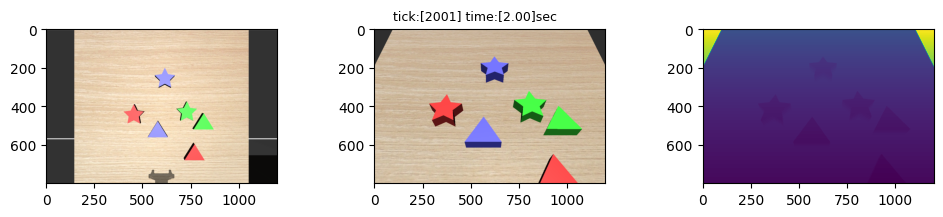

./prism/shape/8/scene_img_1.png
Moved object `obj_triangle_blue` to ['0.579', '-0.133', '0.840']
move obj_triangle_blue to obj_triangle_green


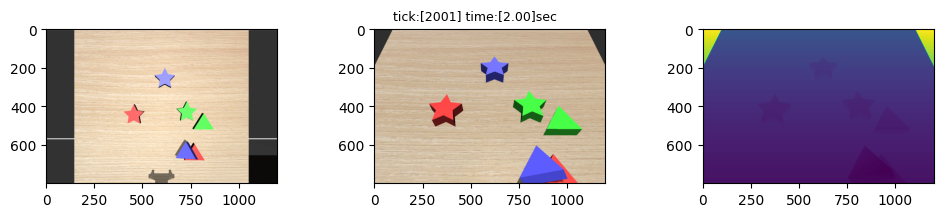

./prism/shape/8/scene_img_2.png
Moved object `obj_star_green` to ['0.829', '-0.091', '0.840']
move obj_star_green to obj_star_blue


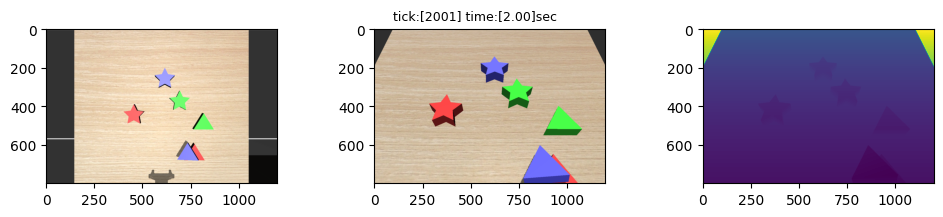

./prism/shape/8/scene_img_3.png
Moved object `obj_star_red` to ['1.014', '0.076', '0.840']
move obj_star_red to obj_star_blue


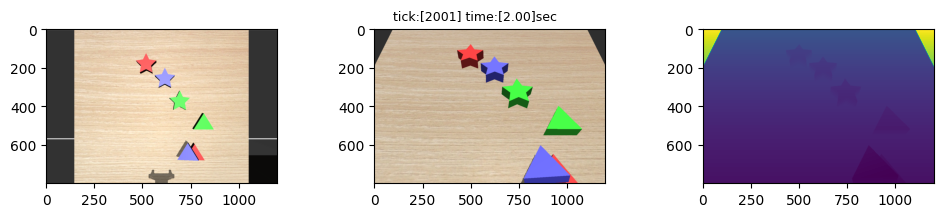

./prism/shape/8/scene_img_4.png
MODE: window
MODE: window


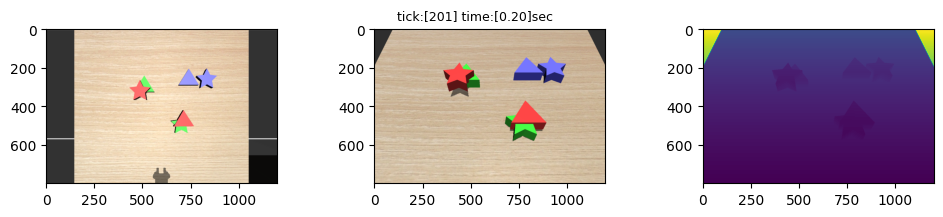

./prism/shape/9/scene_img_0.png
Moved object `obj_star_green` to ['1.054', '-0.244', '0.840']
move obj_star_green to obj_star_blue


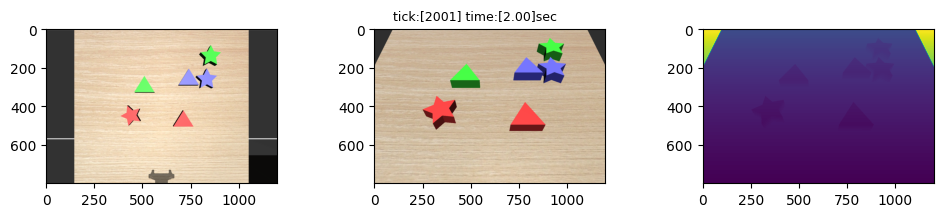

./prism/shape/9/scene_img_1.png
Moved object `obj_star_red` to ['0.924', '-0.339', '0.840']
move obj_star_red to obj_star_blue


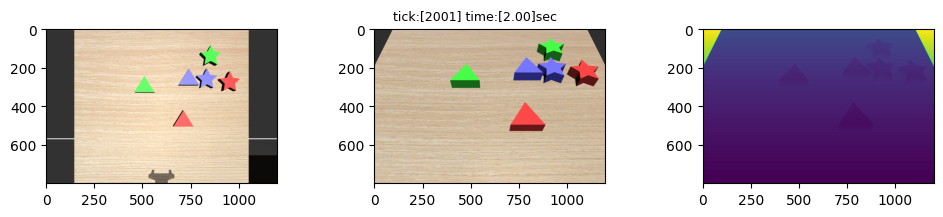

./prism/shape/9/scene_img_2.png
Moved object `obj_triangle_red` to ['0.805', '0.023', '0.840']
move obj_triangle_red to obj_triangle_green


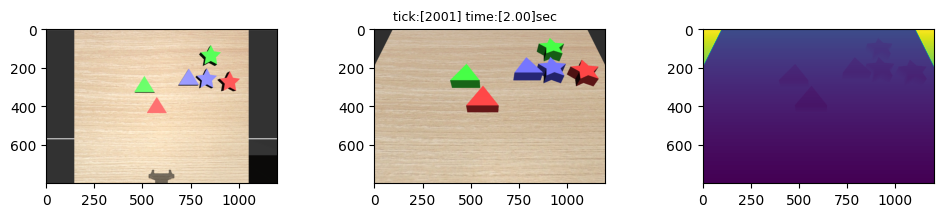

./prism/shape/9/scene_img_3.png
Moved object `obj_triangle_blue` to ['1.038', '0.099', '0.840']
move obj_triangle_blue to obj_triangle_green


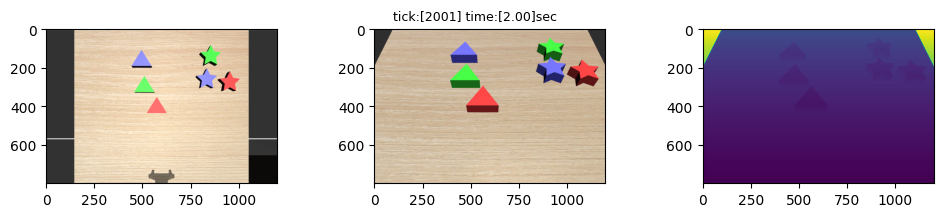

./prism/shape/9/scene_img_4.png
MODE: window
MODE: window


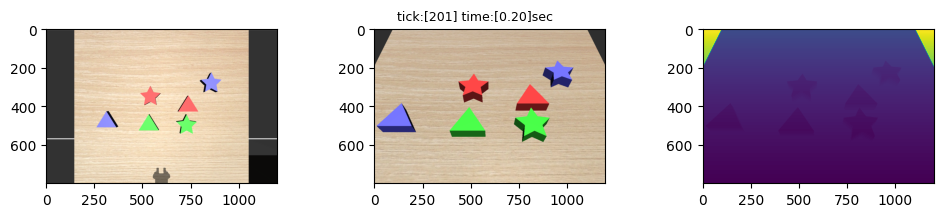

./prism/shape/10/scene_img_0.png
Moved object `obj_star_green` to ['1.009', '-0.178', '0.840']
move obj_star_green to obj_star_blue


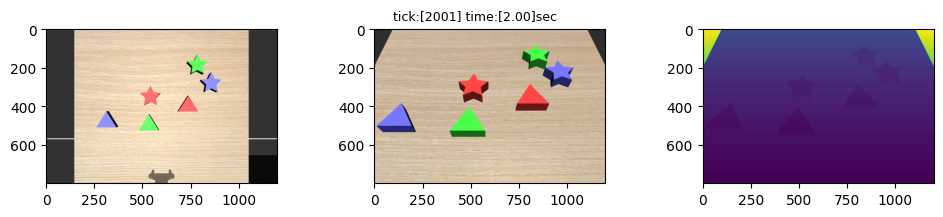

./prism/shape/10/scene_img_1.png
Moved object `obj_star_red` to ['0.945', '-0.364', '0.840']
move obj_star_red to obj_star_blue


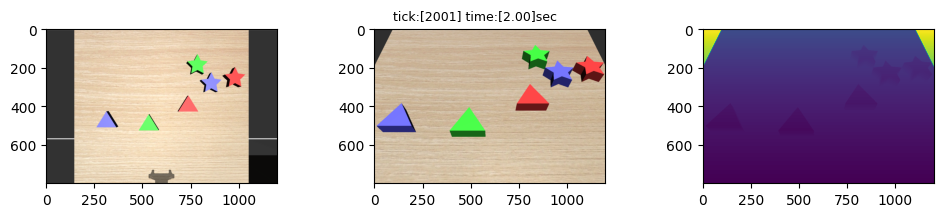

./prism/shape/10/scene_img_2.png
Moved object `obj_triangle_green` to ['0.592', '0.231', '0.840']
move obj_triangle_green to obj_triangle_blue


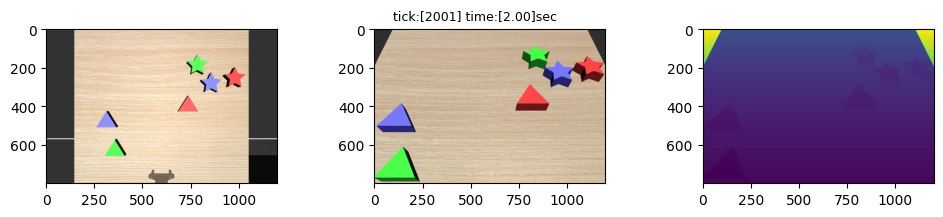

./prism/shape/10/scene_img_3.png
Moved object `obj_triangle_red` to ['0.595', '0.348', '0.840']
move obj_triangle_red to obj_triangle_blue


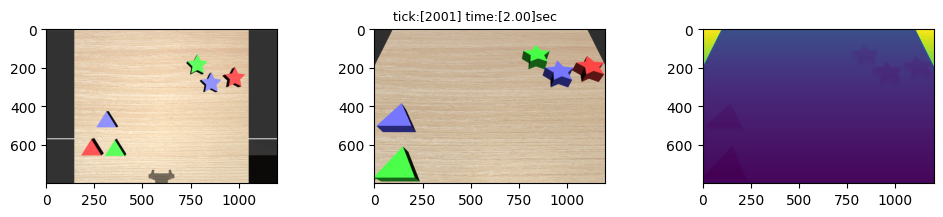

./prism/shape/10/scene_img_4.png
MODE: window
MODE: window


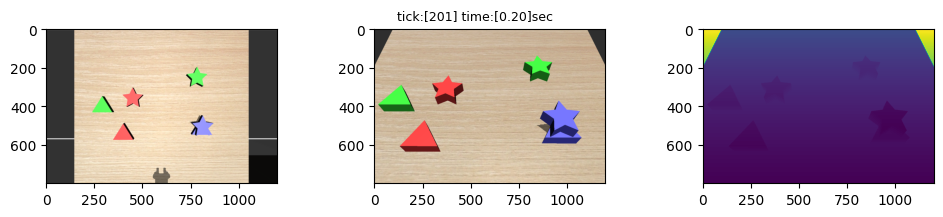

./prism/shape/11/scene_img_0.png
Moved object `obj_triangle_red` to ['0.861', '0.151', '0.840']
move obj_triangle_red to obj_triangle_green


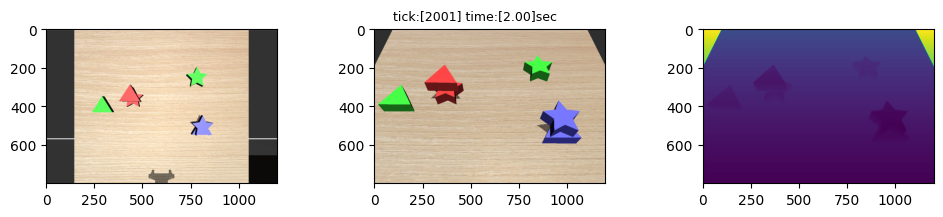

./prism/shape/11/scene_img_1.png
Moved object `obj_triangle_blue` to ['0.794', '0.421', '0.840']
move obj_triangle_blue to obj_triangle_green


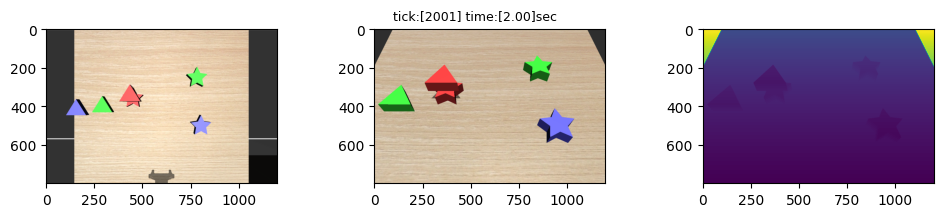

./prism/shape/11/scene_img_2.png
Moved object `obj_star_green` to ['0.604', '-0.225', '0.840']
move obj_star_green to obj_star_blue


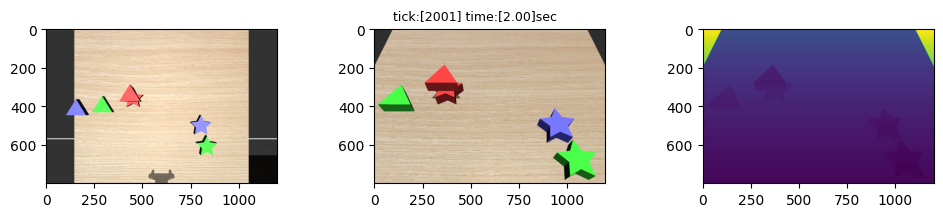

./prism/shape/11/scene_img_3.png
Moved object `obj_star_red` to ['0.817', '-0.231', '0.840']
move obj_star_red to obj_star_blue


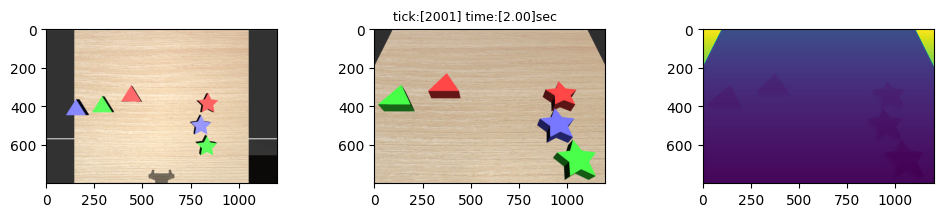

./prism/shape/11/scene_img_4.png
[sample_xyzs] iter_tick:[1001] is over 1000.
MODE: window
MODE: window


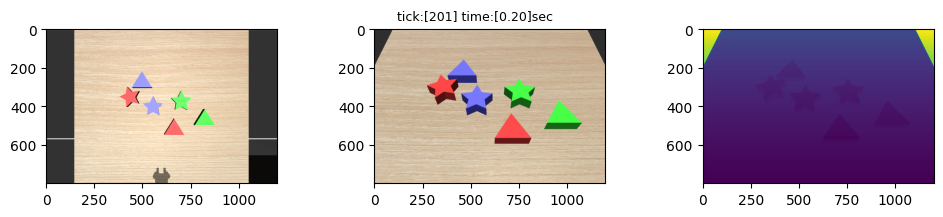

./prism/shape/12/scene_img_0.png
Moved object `obj_star_green` to ['0.775', '0.242', '0.840']
move obj_star_green to obj_star_red


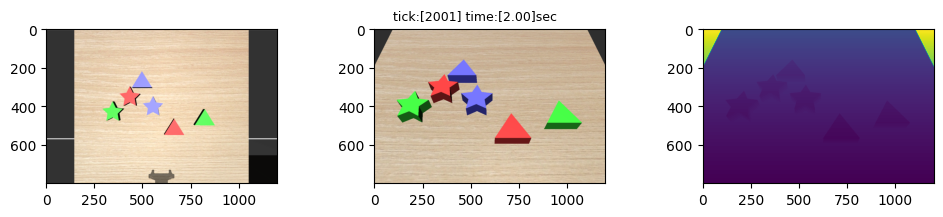

./prism/shape/12/scene_img_1.png
Moved object `obj_star_blue` to ['0.965', '0.196', '0.840']
move obj_star_blue to obj_star_red


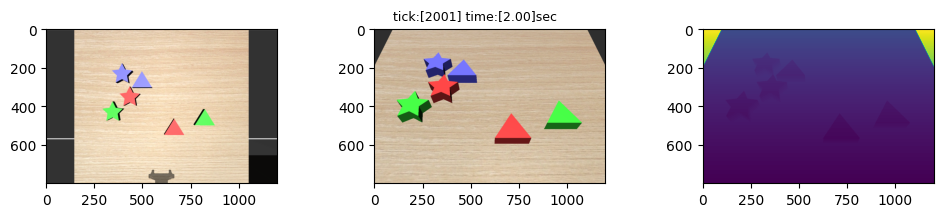

./prism/shape/12/scene_img_2.png
Moved object `obj_triangle_red` to ['0.882', '-0.254', '0.840']
move obj_triangle_red to obj_triangle_green


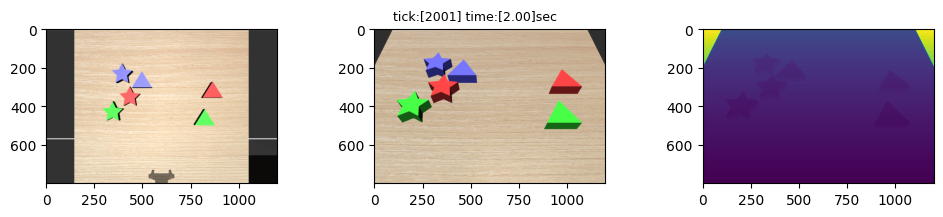

./prism/shape/12/scene_img_3.png
Moved object `obj_triangle_blue` to ['0.812', '-0.356', '0.840']
move obj_triangle_blue to obj_triangle_green


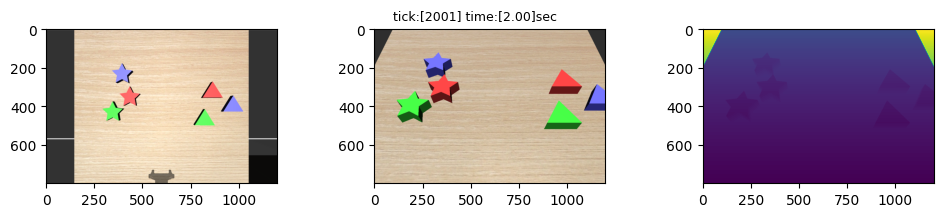

./prism/shape/12/scene_img_4.png
MODE: window
MODE: window


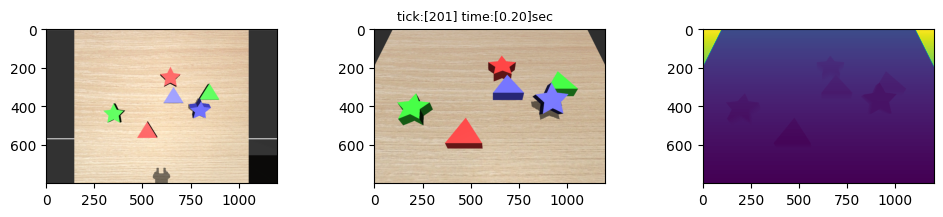

./prism/shape/13/scene_img_0.png
Moved object `obj_star_red` to ['0.859', '0.289', '0.840']
move obj_star_red to obj_star_green


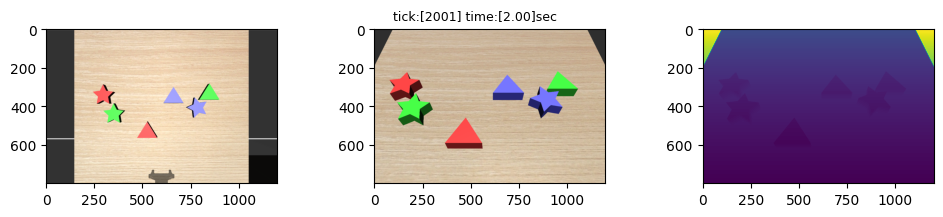

./prism/shape/13/scene_img_1.png
Moved object `obj_star_blue` to ['0.681', '0.319', '0.840']
move obj_star_blue to obj_star_green


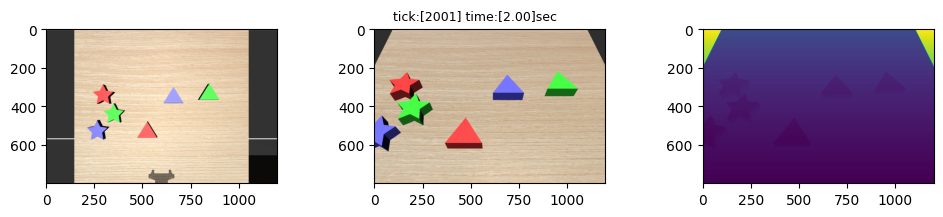

./prism/shape/13/scene_img_2.png
Moved object `obj_triangle_red` to ['1.005', '-0.233', '0.840']
move obj_triangle_red to obj_triangle_green


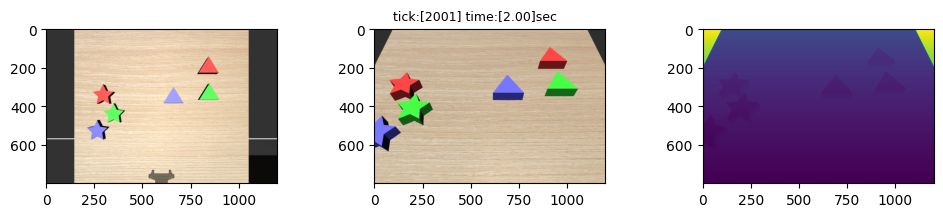

./prism/shape/13/scene_img_3.png
Moved object `obj_triangle_blue` to ['0.817', '-0.328', '0.840']
move obj_triangle_blue to obj_triangle_green


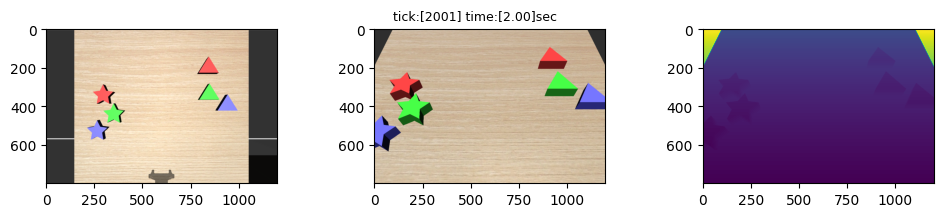

./prism/shape/13/scene_img_4.png
MODE: window
MODE: window


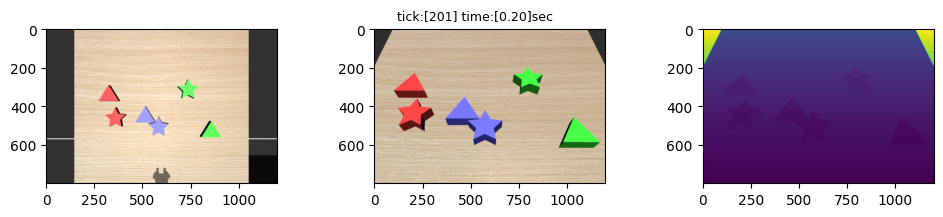

./prism/shape/14/scene_img_0.png
Moved object `obj_star_green` to ['0.751', '0.095', '0.839']
move obj_star_green to obj_star_red


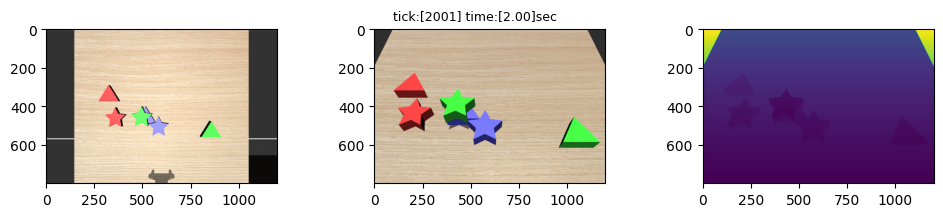

./prism/shape/14/scene_img_1.png
Moved object `obj_star_blue` to ['0.776', '0.106', '0.840']
move obj_star_blue to obj_star_red


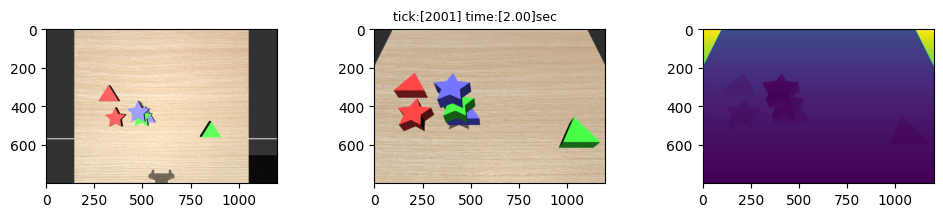

./prism/shape/14/scene_img_2.png
Moved object `obj_triangle_red` to ['0.557', '-0.294', '0.840']
move obj_triangle_red to obj_triangle_green


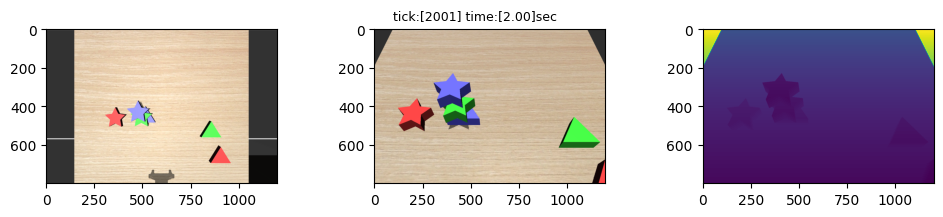

./prism/shape/14/scene_img_3.png
Moved object `obj_triangle_blue` to ['0.573', '-0.256', '0.840']
move obj_triangle_blue to obj_triangle_green


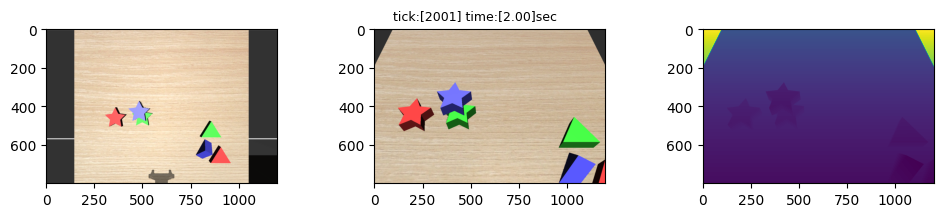

./prism/shape/14/scene_img_4.png
MODE: window
MODE: window


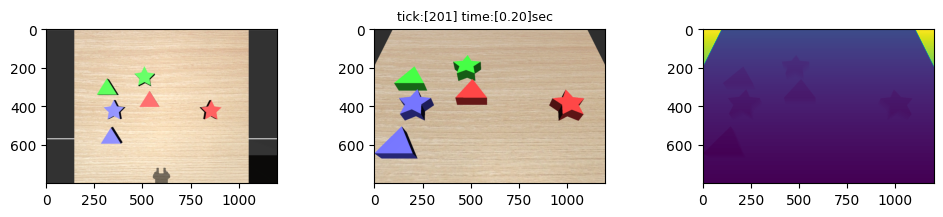

./prism/shape/15/scene_img_0.png
Moved object `obj_star_green` to ['0.731', '-0.129', '0.839']
move obj_star_green to obj_star_red


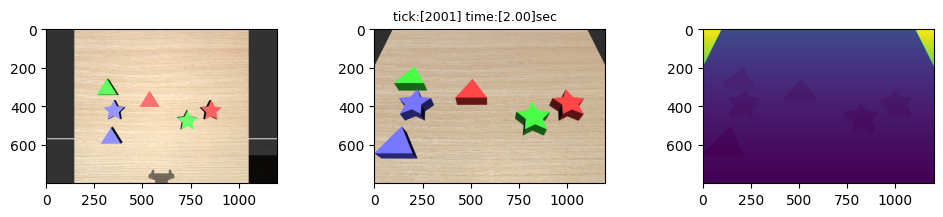

./prism/shape/15/scene_img_1.png
Moved object `obj_star_blue` to ['0.870', '-0.297', '0.840']
move obj_star_blue to obj_star_red


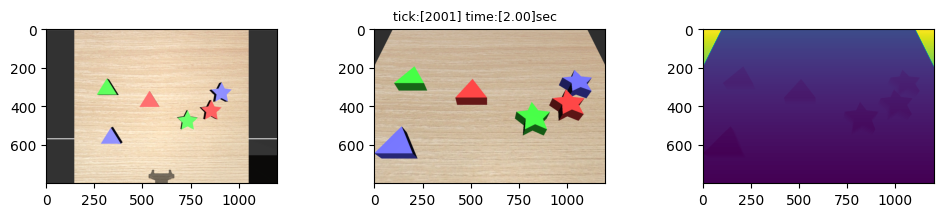

./prism/shape/15/scene_img_2.png
Moved object `obj_triangle_green` to ['0.780', '0.254', '0.840']
move obj_triangle_green to obj_triangle_blue


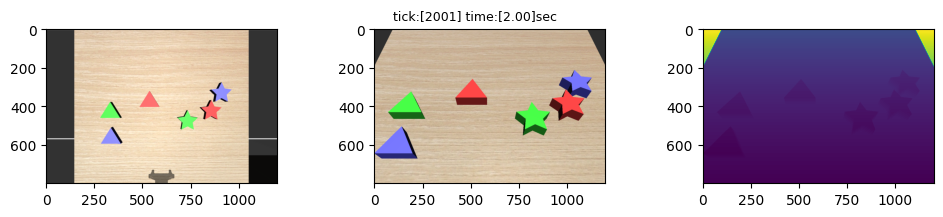

./prism/shape/15/scene_img_3.png
Moved object `obj_triangle_red` to ['0.690', '0.108', '0.840']
move obj_triangle_red to obj_triangle_blue


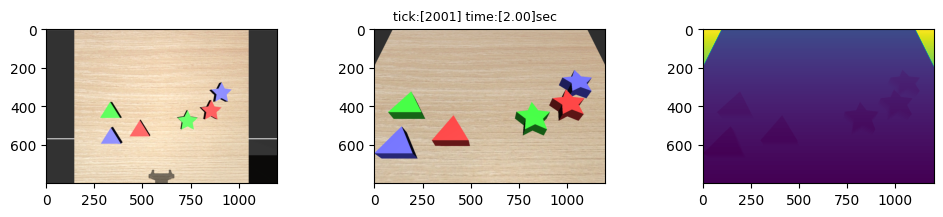

./prism/shape/15/scene_img_4.png
MODE: window
MODE: window


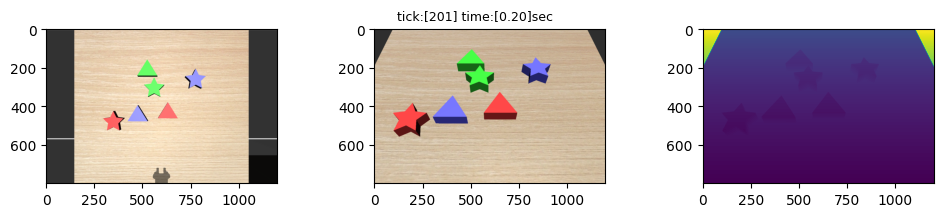

./prism/shape/16/scene_img_0.png
Moved object `obj_star_green` to ['1.022', '-0.097', '0.840']
move obj_star_green to obj_star_blue


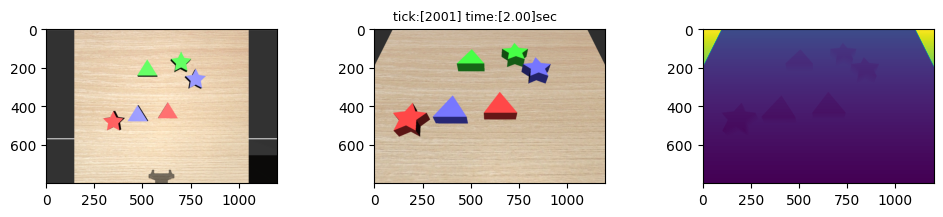

./prism/shape/16/scene_img_1.png
Moved object `obj_star_red` to ['0.831', '-0.110', '0.840']
move obj_star_red to obj_star_blue


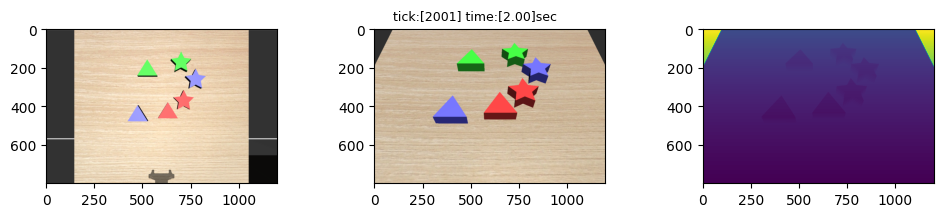

./prism/shape/16/scene_img_2.png
Moved object `obj_triangle_green` to ['0.741', '-0.005', '0.840']
move obj_triangle_green to obj_triangle_blue


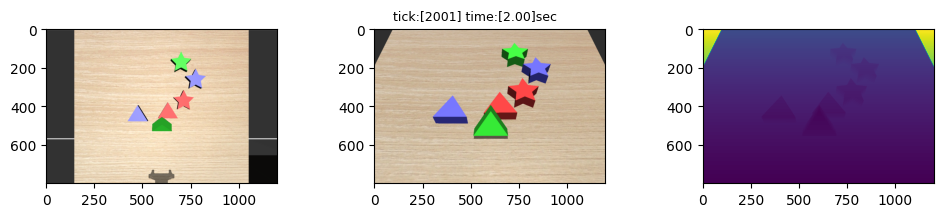

./prism/shape/16/scene_img_3.png
Moved object `obj_triangle_red` to ['0.850', '0.212', '0.840']
move obj_triangle_red to obj_triangle_blue


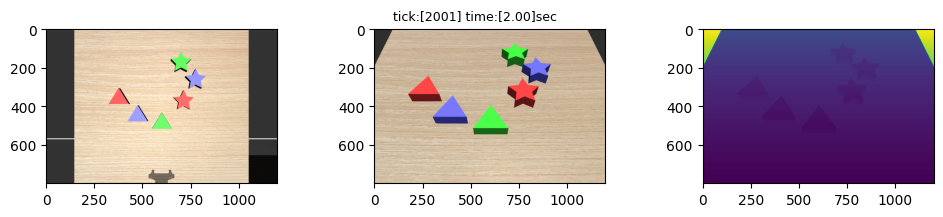

./prism/shape/16/scene_img_4.png
MODE: window
MODE: window


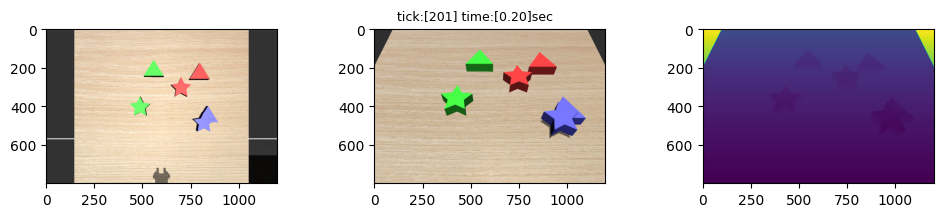

./prism/shape/17/scene_img_0.png
Moved object `obj_triangle_red` to ['0.986', '-0.092', '0.839']
move obj_triangle_red to obj_triangle_green


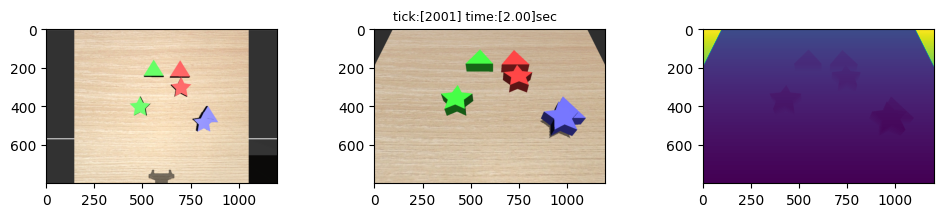

./prism/shape/17/scene_img_1.png
Moved object `obj_triangle_blue` to ['1.076', '-0.066', '0.840']
move obj_triangle_blue to obj_triangle_green


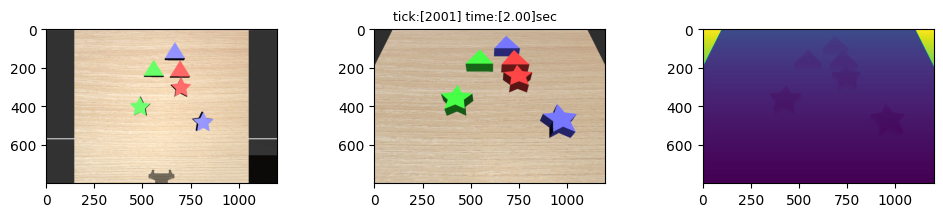

./prism/shape/17/scene_img_2.png
Moved object `obj_star_green` to ['0.814', '-0.124', '0.840']
move obj_star_green to obj_star_blue


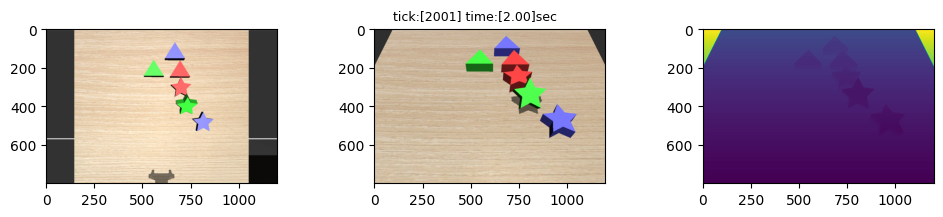

./prism/shape/17/scene_img_3.png
Moved object `obj_star_red` to ['0.619', '-0.126', '0.840']
move obj_star_red to obj_star_blue


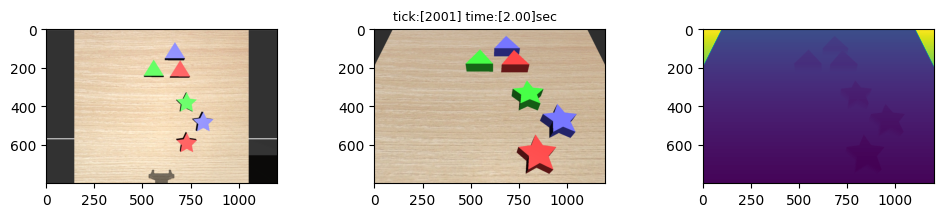

./prism/shape/17/scene_img_4.png
MODE: window
MODE: window


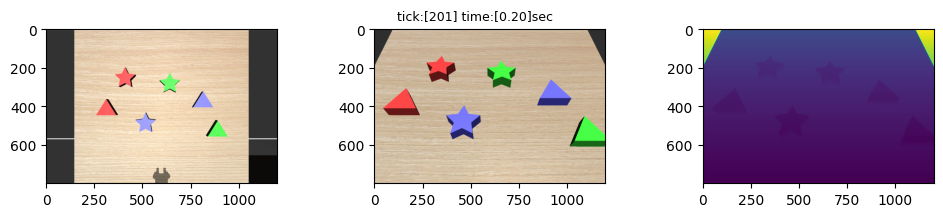

./prism/shape/18/scene_img_0.png
Moved object `obj_star_green` to ['0.895', '0.091', '0.839']
move obj_star_green to obj_star_red


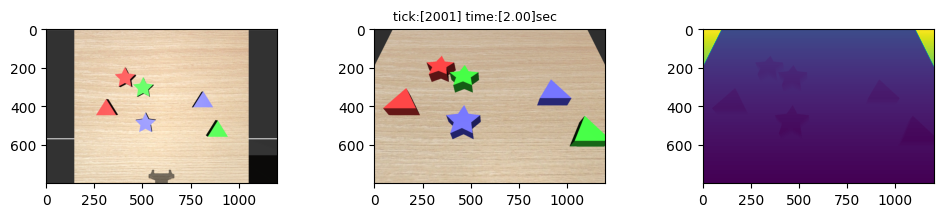

./prism/shape/18/scene_img_1.png
Moved object `obj_star_blue` to ['0.856', '0.232', '0.840']
move obj_star_blue to obj_star_red


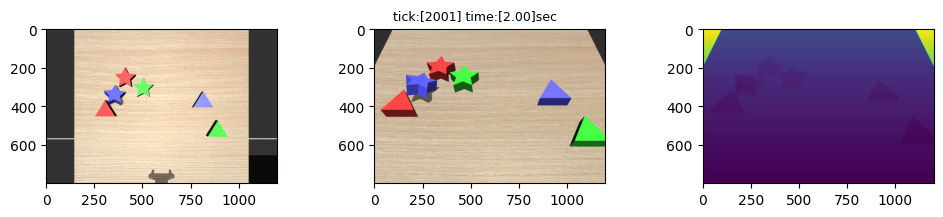

./prism/shape/18/scene_img_2.png
Moved object `obj_triangle_red` to ['0.798', '-0.303', '0.840']
move obj_triangle_red to obj_triangle_green


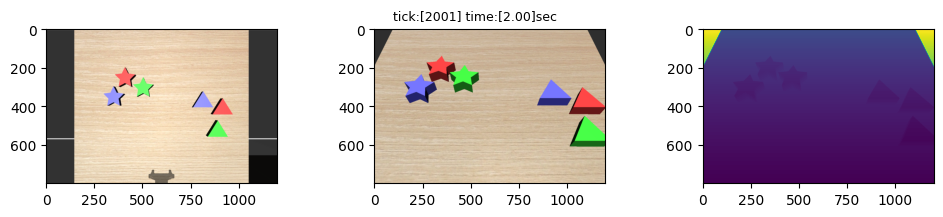

./prism/shape/18/scene_img_3.png
Moved object `obj_triangle_blue` to ['0.612', '-0.148', '0.840']
move obj_triangle_blue to obj_triangle_green


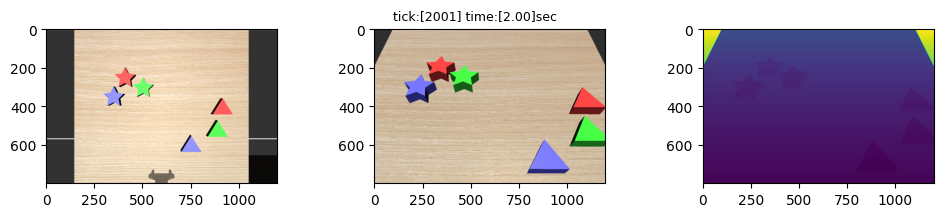

./prism/shape/18/scene_img_4.png
MODE: window
MODE: window


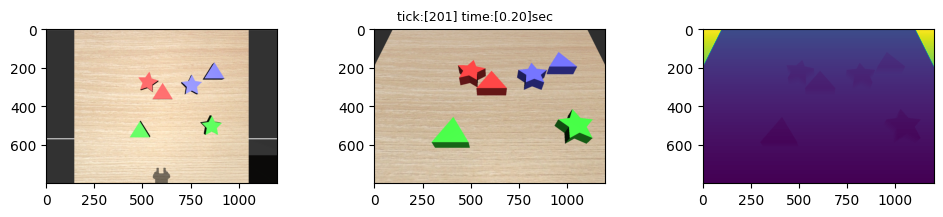

./prism/shape/19/scene_img_0.png
Moved object `obj_triangle_red` to ['0.521', '0.117', '0.839']
move obj_triangle_red to obj_triangle_green


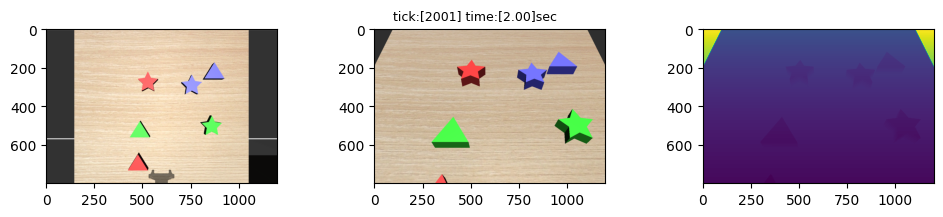

./prism/shape/19/scene_img_1.png
Moved object `obj_triangle_blue` to ['0.768', '0.007', '0.840']
move obj_triangle_blue to obj_triangle_green


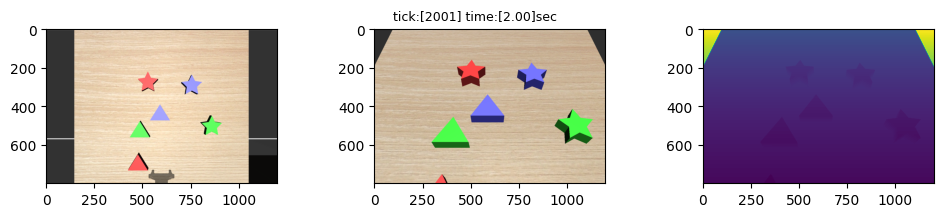

./prism/shape/19/scene_img_2.png
Moved object `obj_star_green` to ['1.028', '-0.155', '0.840']
move obj_star_green to obj_star_blue


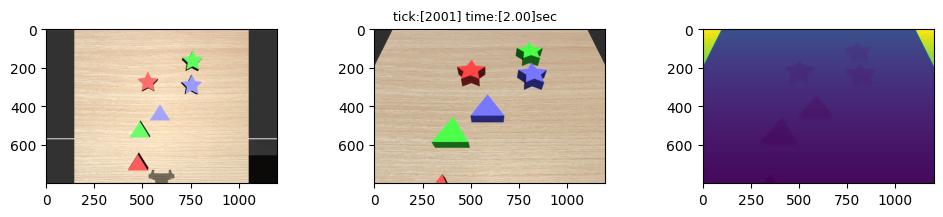

./prism/shape/19/scene_img_3.png
Moved object `obj_star_red` to ['0.865', '-0.245', '0.840']
move obj_star_red to obj_star_blue


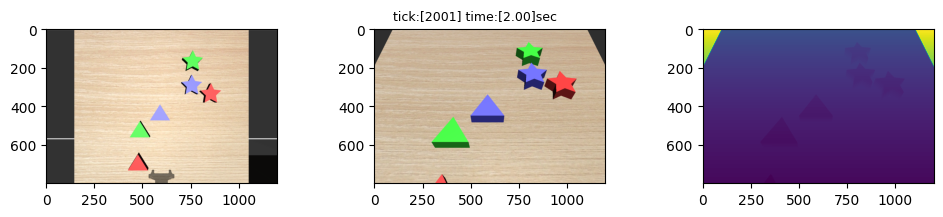

./prism/shape/19/scene_img_4.png
MODE: window
MODE: window


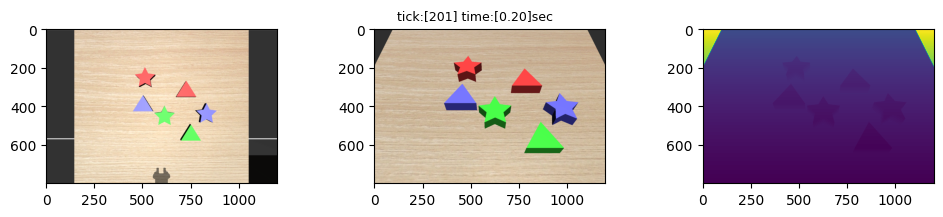

./prism/shape/20/scene_img_0.png
Moved object `obj_triangle_red` to ['0.767', '-0.256', '0.839']
move obj_triangle_red to obj_triangle_green


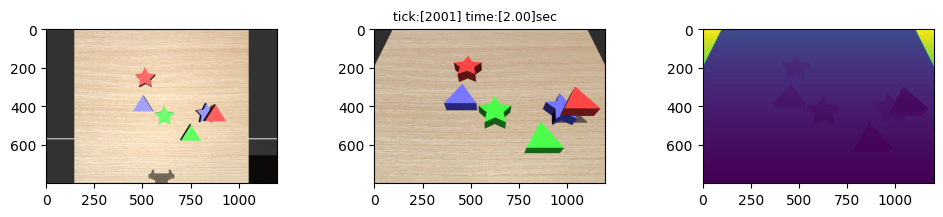

./prism/shape/20/scene_img_1.png
Moved object `obj_triangle_blue` to ['0.556', '-0.186', '0.840']
move obj_triangle_blue to obj_triangle_green


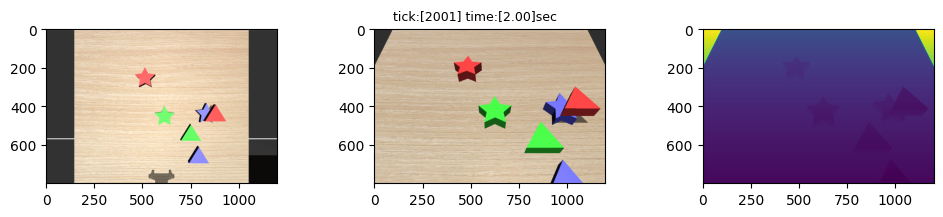

./prism/shape/20/scene_img_2.png
Moved object `obj_star_green` to ['0.847', '0.149', '0.840']
move obj_star_green to obj_star_red


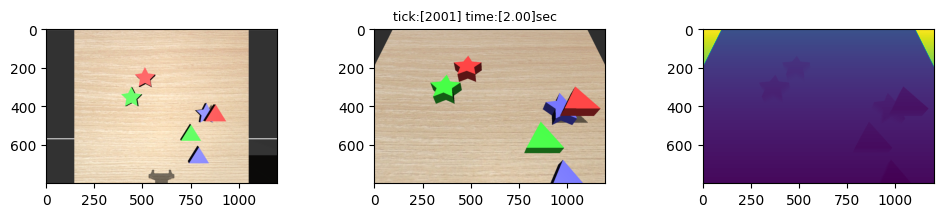

./prism/shape/20/scene_img_3.png
Moved object `obj_star_blue` to ['0.876', '0.168', '0.840']
move obj_star_blue to obj_star_red


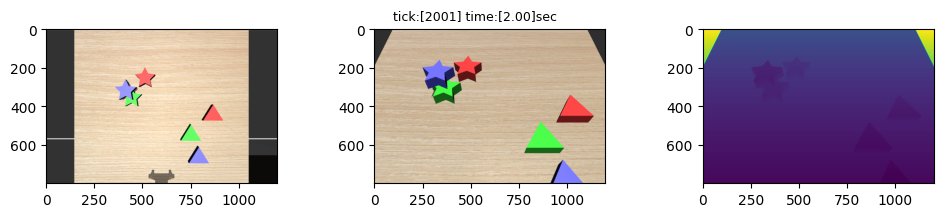

./prism/shape/20/scene_img_4.png
MODE: window
MODE: window


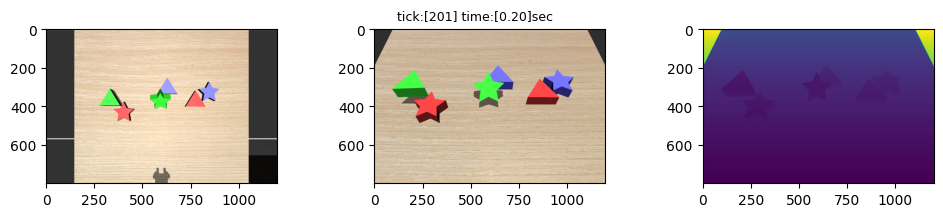

./prism/shape/21/scene_img_0.png
Moved object `obj_triangle_red` to ['0.888', '0.385', '0.876']
move obj_triangle_red to obj_triangle_green


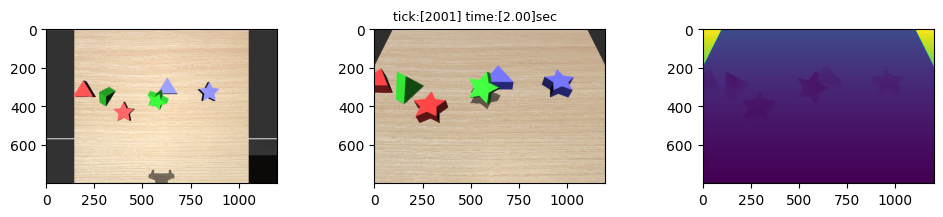

./prism/shape/21/scene_img_1.png
Moved object `obj_triangle_blue` to ['0.942', '0.356', '0.863']
move obj_triangle_blue to obj_triangle_green


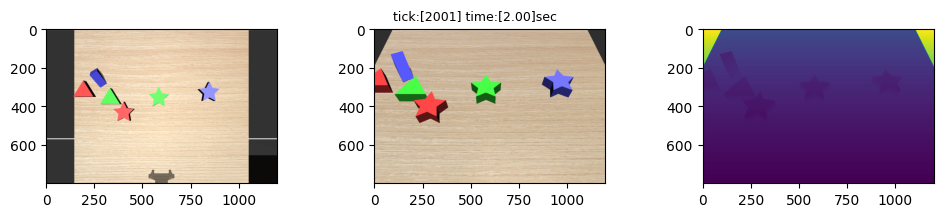

./prism/shape/21/scene_img_2.png
Moved object `obj_star_green` to ['0.929', '-0.338', '0.840']
move obj_star_green to obj_star_blue


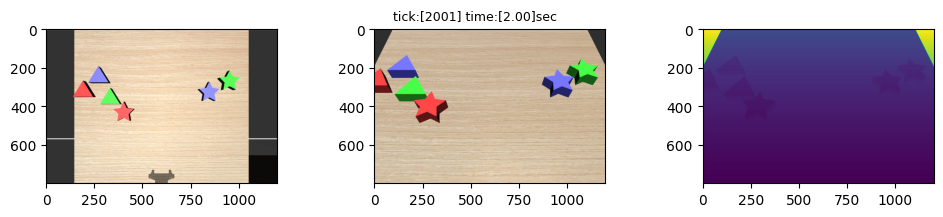

./prism/shape/21/scene_img_3.png
Moved object `obj_star_red` to ['0.879', '-0.128', '0.840']
move obj_star_red to obj_star_blue


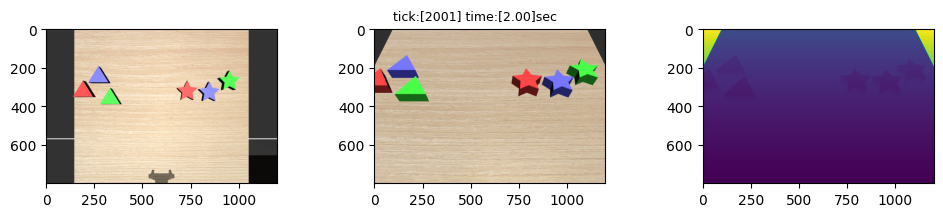

./prism/shape/21/scene_img_4.png
MODE: window
MODE: window


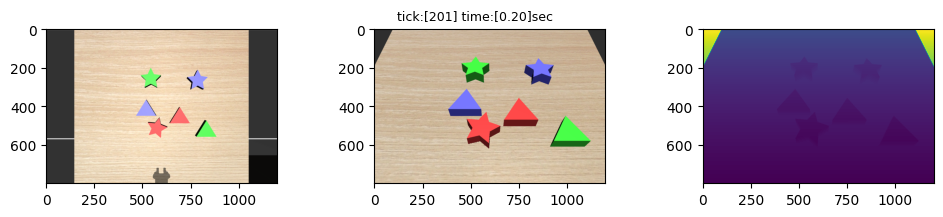

./prism/shape/22/scene_img_0.png
Moved object `obj_triangle_red` to ['0.762', '-0.297', '0.840']
move obj_triangle_red to obj_triangle_green


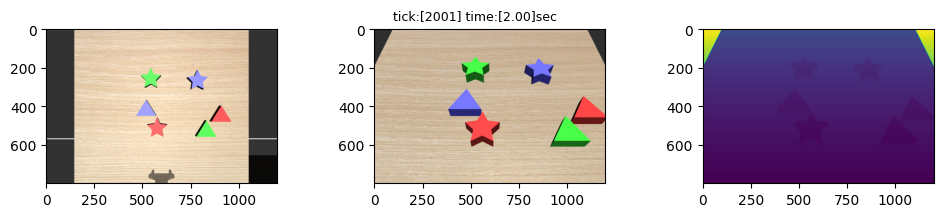

./prism/shape/22/scene_img_1.png
Moved object `obj_triangle_blue` to ['0.700', '-0.367', '0.840']
move obj_triangle_blue to obj_triangle_green


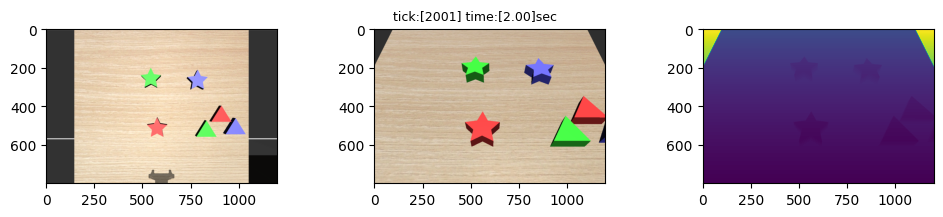

./prism/shape/22/scene_img_2.png
Moved object `obj_star_red` to ['0.924', '-0.049', '0.840']
move obj_star_red to obj_star_green


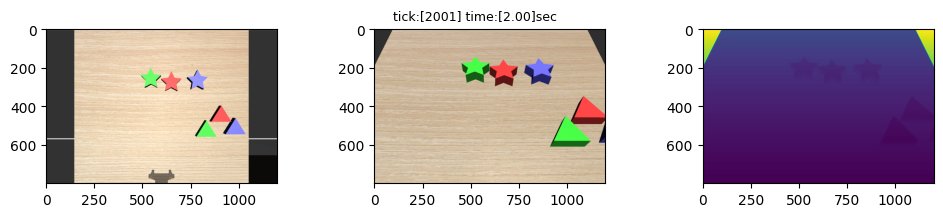

./prism/shape/22/scene_img_3.png
Moved object `obj_star_blue` to ['0.894', '0.177', '0.840']
move obj_star_blue to obj_star_green


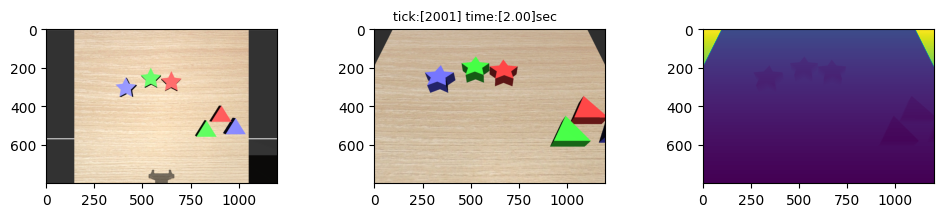

./prism/shape/22/scene_img_4.png
MODE: window
MODE: window


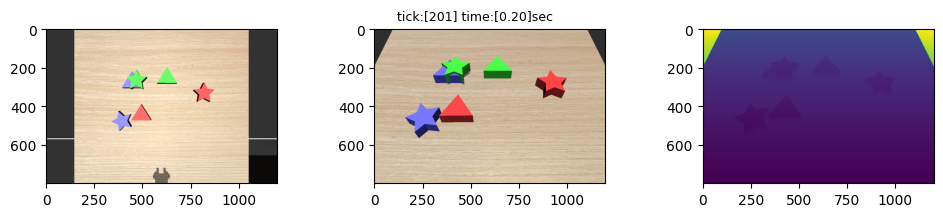

./prism/shape/23/scene_img_0.png
Moved object `obj_star_green` to ['0.750', '-0.203', '0.840']
move obj_star_green to obj_star_red


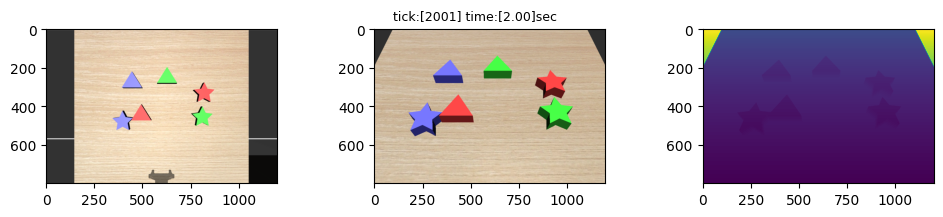

./prism/shape/23/scene_img_1.png
Moved object `obj_star_blue` to ['0.988', '-0.159', '0.840']
move obj_star_blue to obj_star_red


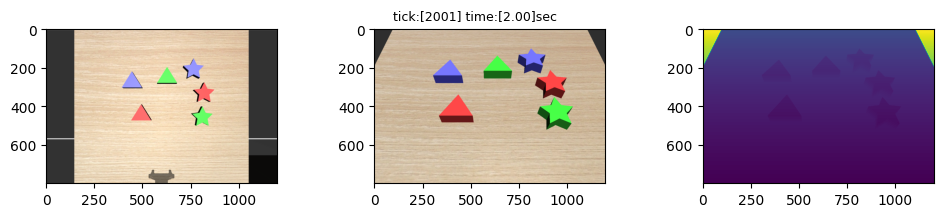

./prism/shape/23/scene_img_2.png
Moved object `obj_triangle_green` to ['0.933', '-0.010', '0.840']
move obj_triangle_green to obj_triangle_blue


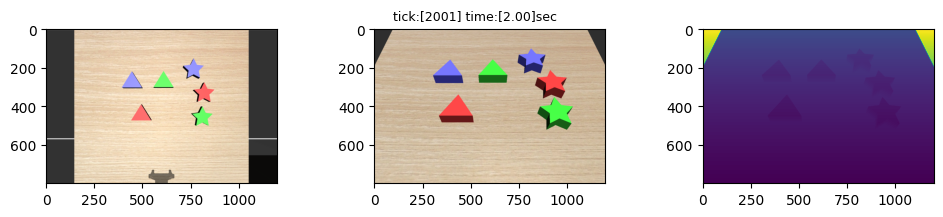

./prism/shape/23/scene_img_3.png
Moved object `obj_triangle_red` to ['0.823', '0.197', '0.840']
move obj_triangle_red to obj_triangle_blue


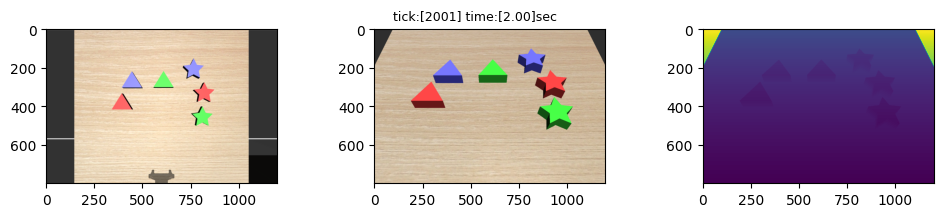

./prism/shape/23/scene_img_4.png
MODE: window
MODE: window


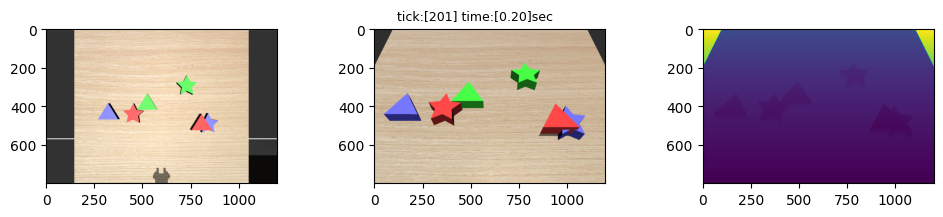

./prism/shape/24/scene_img_0.png
Moved object `obj_triangle_green` to ['0.926', '0.204', '0.840']
move obj_triangle_green to obj_triangle_blue


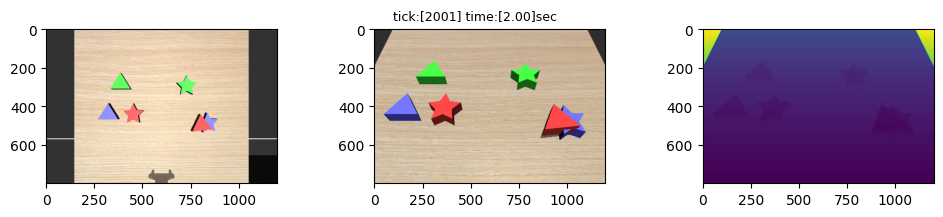

./prism/shape/24/scene_img_1.png
Moved object `obj_triangle_red` to ['0.688', '0.324', '0.840']
move obj_triangle_red to obj_triangle_blue


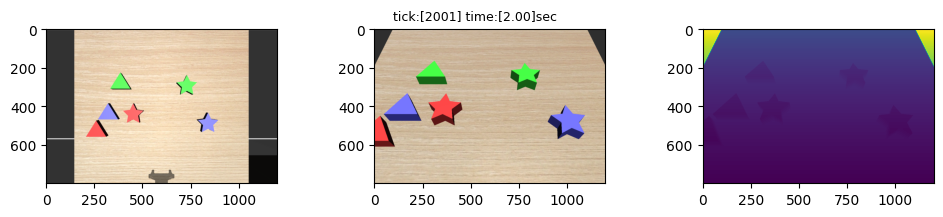

./prism/shape/24/scene_img_2.png
Moved object `obj_star_green` to ['0.767', '-0.129', '0.840']
move obj_star_green to obj_star_blue


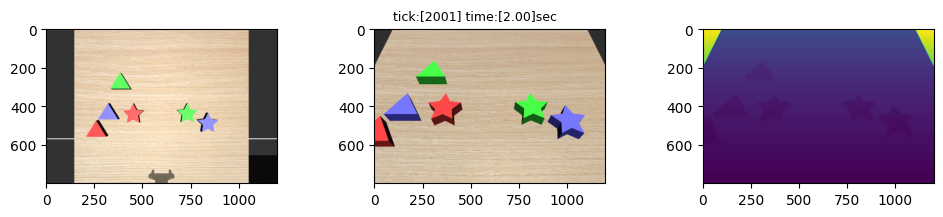

./prism/shape/24/scene_img_3.png
Moved object `obj_star_red` to ['0.839', '-0.196', '0.840']
move obj_star_red to obj_star_blue


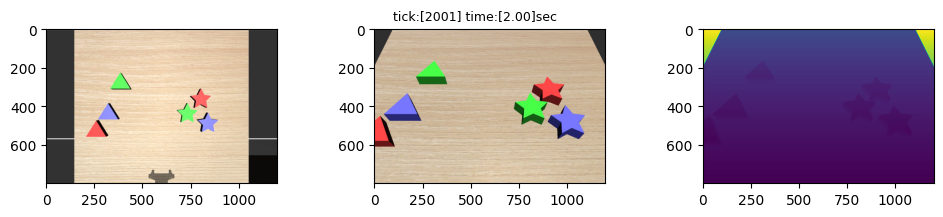

./prism/shape/24/scene_img_4.png
MODE: window
MODE: window


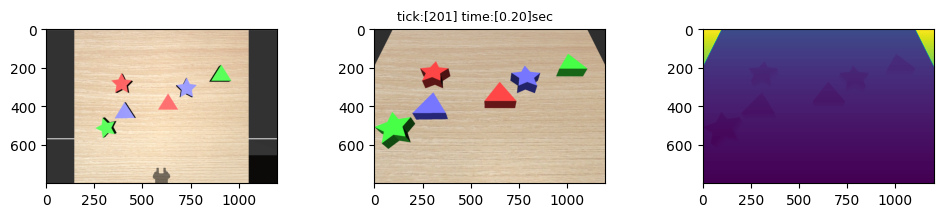

./prism/shape/25/scene_img_0.png
Moved object `obj_star_red` to ['0.619', '0.354', '0.840']
move obj_star_red to obj_star_green


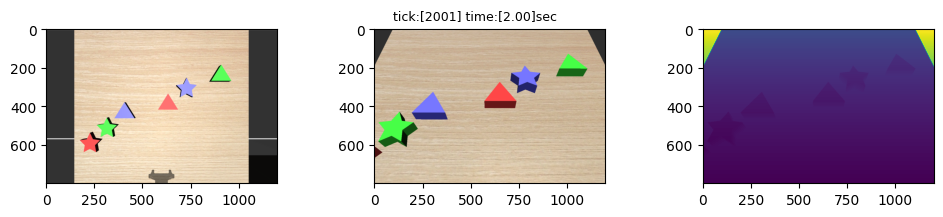

./prism/shape/25/scene_img_1.png
Moved object `obj_star_blue` to ['0.773', '0.181', '0.840']
move obj_star_blue to obj_star_green


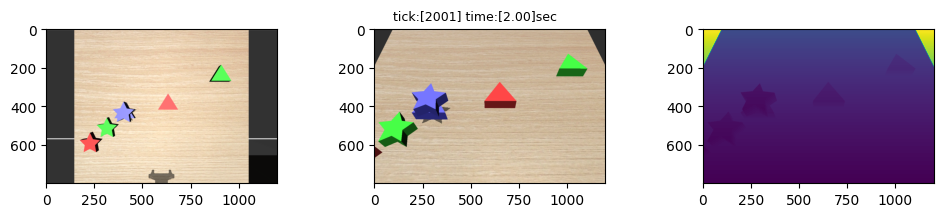

./prism/shape/25/scene_img_2.png
Moved object `obj_triangle_red` to ['1.069', '-0.280', '0.840']
move obj_triangle_red to obj_triangle_green


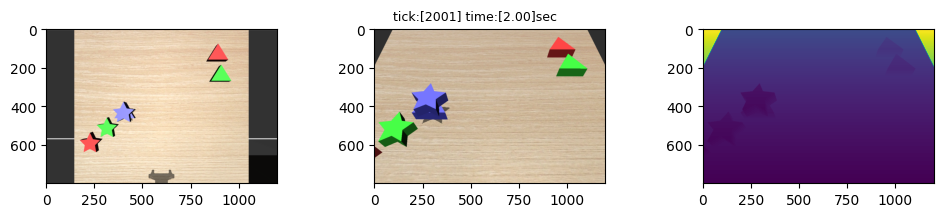

./prism/shape/25/scene_img_3.png
Moved object `obj_triangle_blue` to ['0.892', '-0.421', '0.840']
move obj_triangle_blue to obj_triangle_green


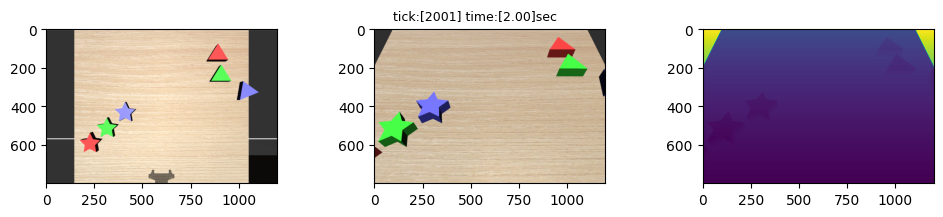

./prism/shape/25/scene_img_4.png
MODE: window
MODE: window


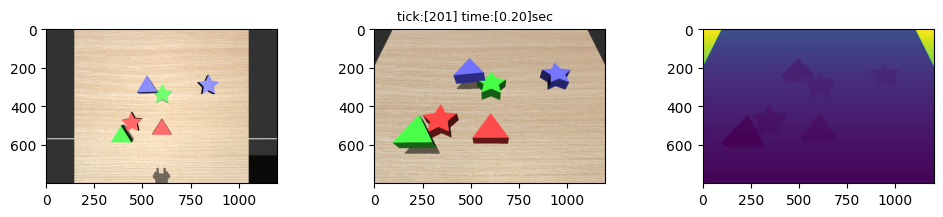

./prism/shape/26/scene_img_0.png
Moved object `obj_triangle_red` to ['0.711', '0.327', '0.879']
move obj_triangle_red to obj_triangle_green


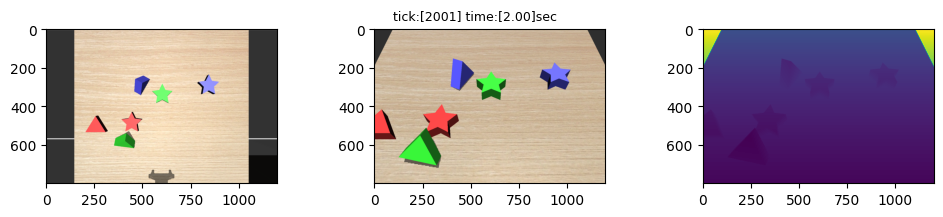

./prism/shape/26/scene_img_1.png
Moved object `obj_triangle_blue` to ['0.651', '0.065', '0.880']
move obj_triangle_blue to obj_triangle_green


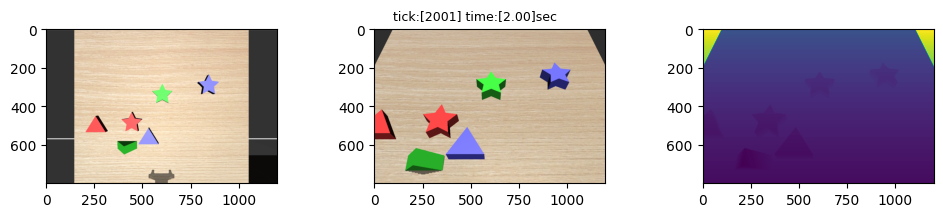

./prism/shape/26/scene_img_2.png
Moved object `obj_star_green` to ['1.017', '-0.223', '0.840']
move obj_star_green to obj_star_blue


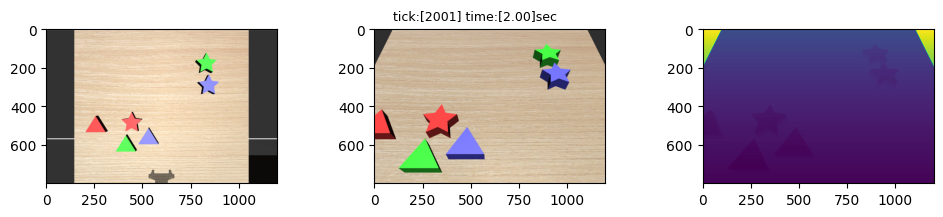

./prism/shape/26/scene_img_3.png
Moved object `obj_star_red` to ['0.783', '-0.215', '0.840']
move obj_star_red to obj_star_blue


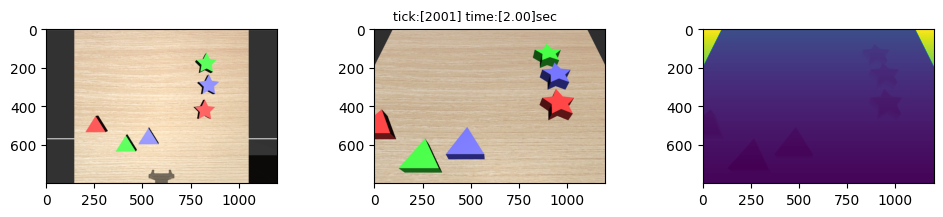

./prism/shape/26/scene_img_4.png
MODE: window
MODE: window


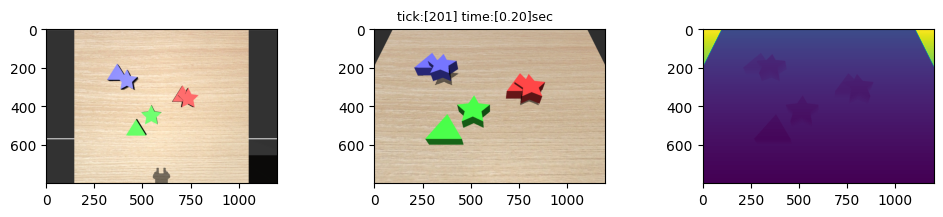

./prism/shape/27/scene_img_0.png
Moved object `obj_triangle_green` to ['1.053', '0.289', '0.840']
move obj_triangle_green to obj_triangle_blue


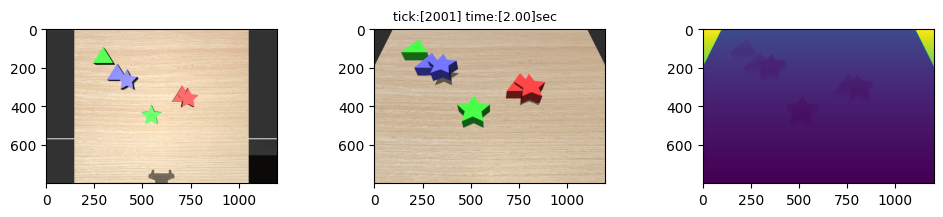

./prism/shape/27/scene_img_1.png
Moved object `obj_triangle_red` to ['0.886', '0.078', '0.840']
move obj_triangle_red to obj_triangle_blue


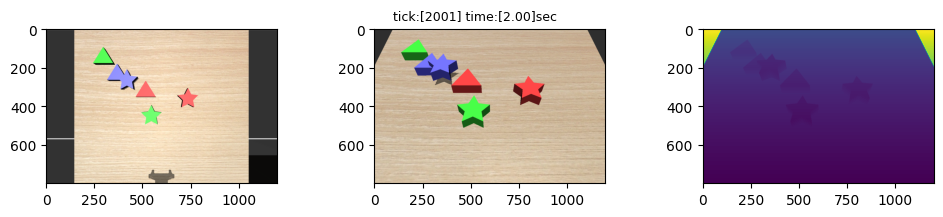

./prism/shape/27/scene_img_2.png
Moved object `obj_star_green` to ['0.960', '-0.150', '0.840']
move obj_star_green to obj_star_red


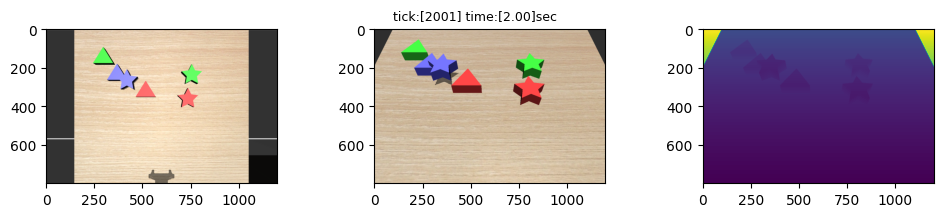

./prism/shape/27/scene_img_3.png
Moved object `obj_star_blue` to ['0.850', '-0.252', '0.840']
move obj_star_blue to obj_star_red


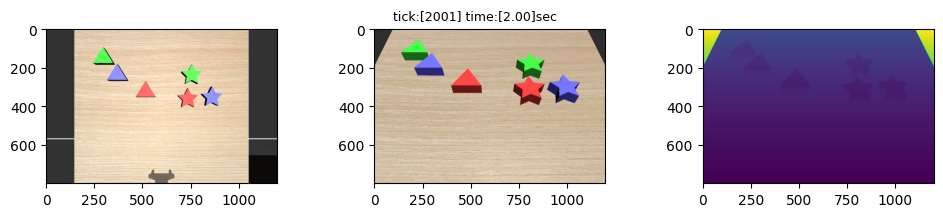

./prism/shape/27/scene_img_4.png
MODE: window
MODE: window


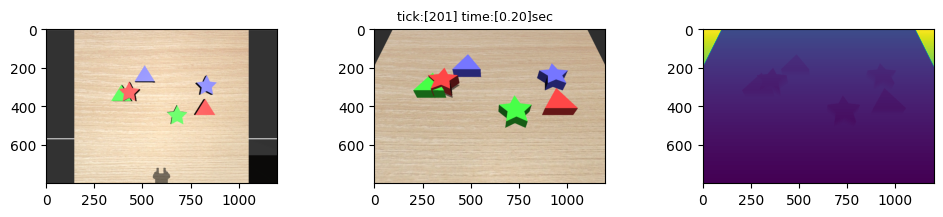

./prism/shape/28/scene_img_0.png
Moved object `obj_triangle_red` to ['1.016', '0.154', '0.840']
move obj_triangle_red to obj_triangle_green


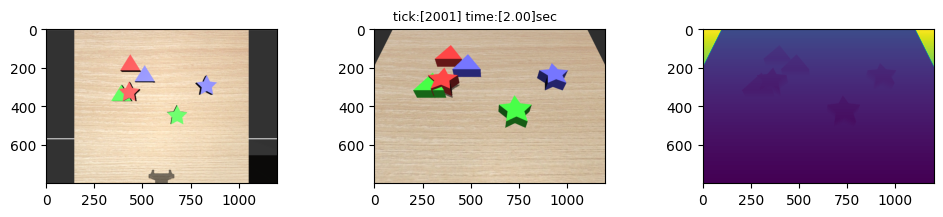

./prism/shape/28/scene_img_1.png
Moved object `obj_triangle_blue` to ['0.751', '0.155', '0.840']
move obj_triangle_blue to obj_triangle_green


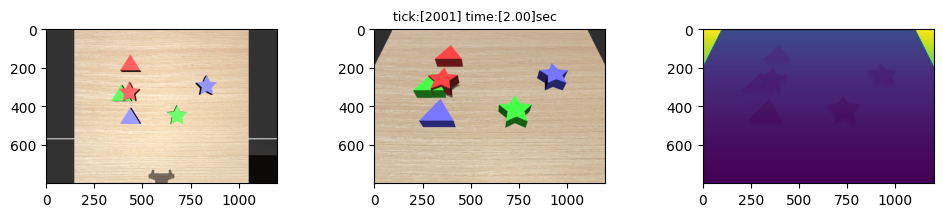

./prism/shape/28/scene_img_2.png
Moved object `obj_star_green` to ['0.981', '-0.118', '0.840']
move obj_star_green to obj_star_blue


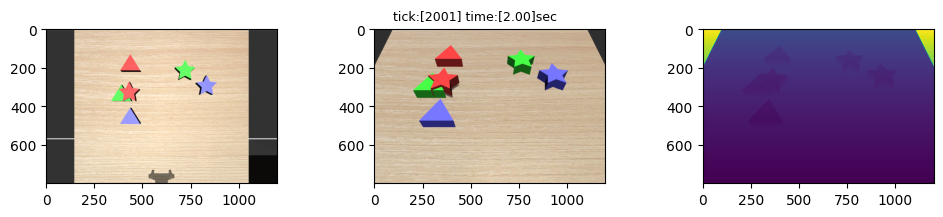

./prism/shape/28/scene_img_3.png
Moved object `obj_star_red` to ['0.793', '-0.163', '0.840']
move obj_star_red to obj_star_blue


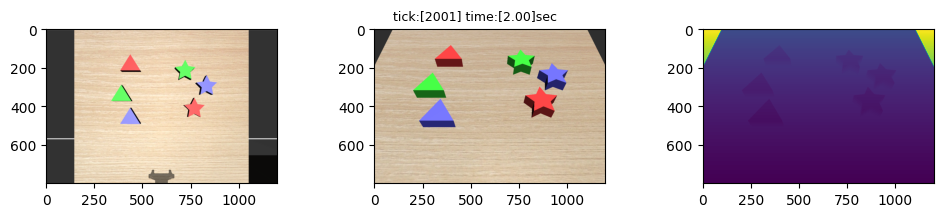

./prism/shape/28/scene_img_4.png
MODE: window
MODE: window


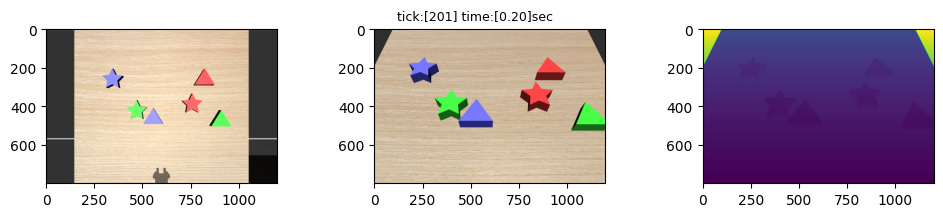

./prism/shape/29/scene_img_0.png
Moved object `obj_star_green` to ['0.906', '0.347', '0.839']
move obj_star_green to obj_star_blue


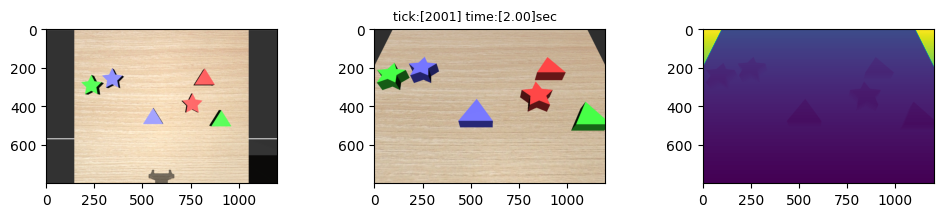

./prism/shape/29/scene_img_1.png
Moved object `obj_star_red` to ['0.824', '0.240', '0.840']
move obj_star_red to obj_star_blue


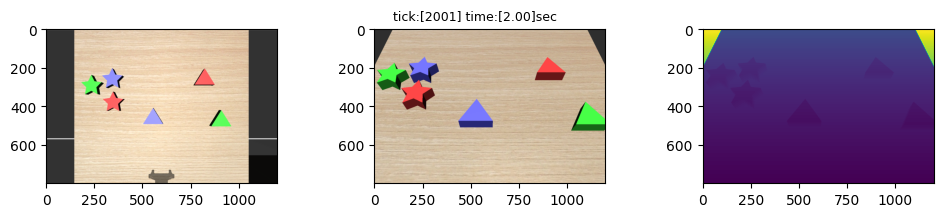

./prism/shape/29/scene_img_2.png
Moved object `obj_triangle_red` to ['0.768', '-0.201', '0.840']
move obj_triangle_red to obj_triangle_green


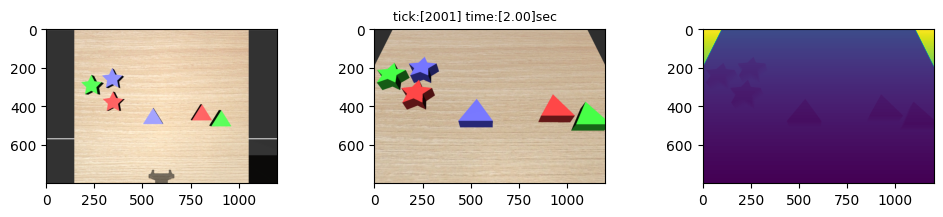

./prism/shape/29/scene_img_3.png
Moved object `obj_triangle_blue` to ['0.676', '-0.174', '0.840']
move obj_triangle_blue to obj_triangle_green


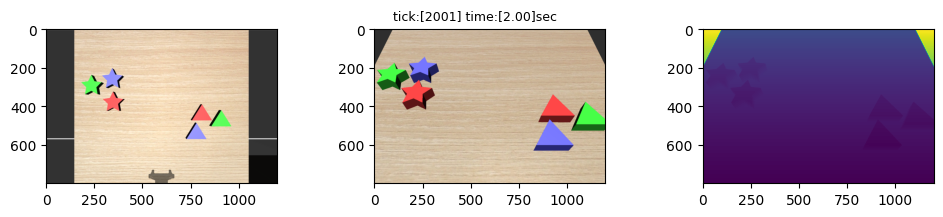

./prism/shape/29/scene_img_4.png
MODE: window
MODE: window


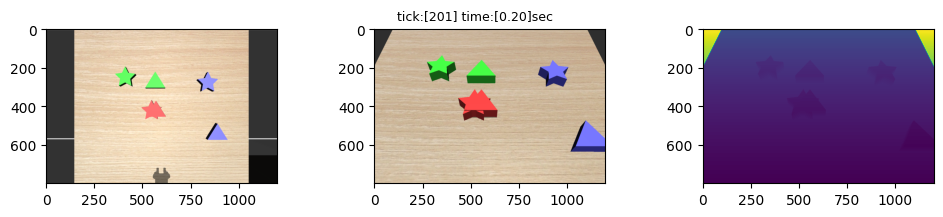

./prism/shape/30/scene_img_0.png
Moved object `obj_star_red` to ['0.845', '0.119', '0.840']
move obj_star_red to obj_star_green


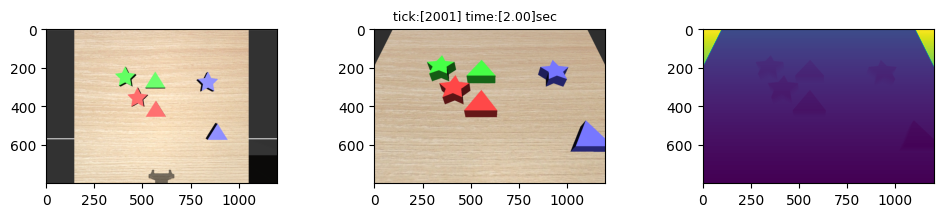

./prism/shape/30/scene_img_1.png
Moved object `obj_star_blue` to ['0.973', '0.060', '0.840']
move obj_star_blue to obj_star_green


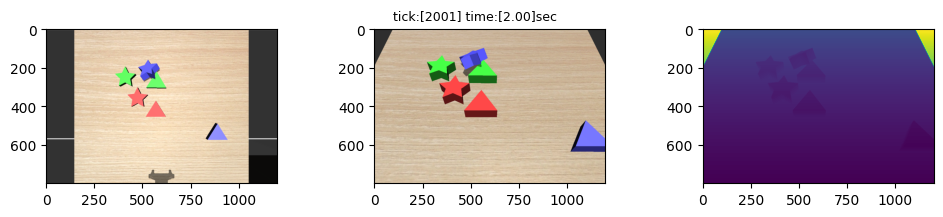

./prism/shape/30/scene_img_2.png
Moved object `obj_triangle_green` to ['0.670', '-0.393', '0.840']
move obj_triangle_green to obj_triangle_blue


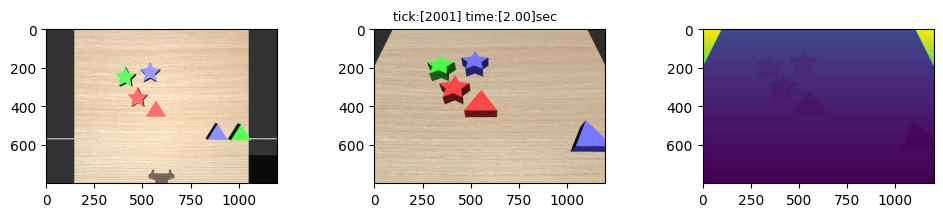

./prism/shape/30/scene_img_3.png
Moved object `obj_triangle_red` to ['0.786', '-0.351', '0.840']
move obj_triangle_red to obj_triangle_blue


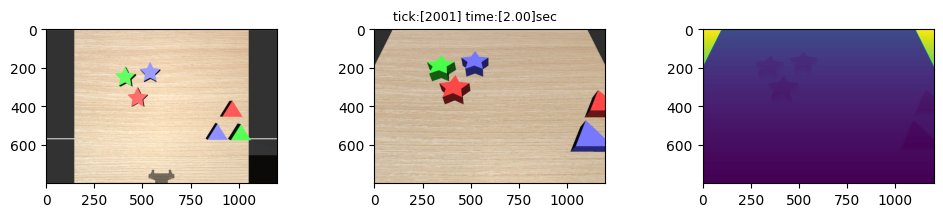

./prism/shape/30/scene_img_4.png


In [8]:
for episode in range(30):
    preference_objective = ["color", "shape"]
    rand_idx = np.random.randint(0,2)
    rand_preference = preference_objective[rand_idx]
    # rand_preference = "color"
    rand_preference = "shape"

    executed_action_list = []
    random_sample_object(env)
    env.set_viewer()
    env.reset()
    env.forward(q=init_pose,joint_idxs=idxs_ur_fwd)
    # Get images
    for _ in range(100): # for loop to place the object
        env.forward(q=init_pose,joint_idxs=idxs_ur_fwd)
        env.step(ctrl=np.append(init_pose,1.0),ctrl_idxs=idxs_ur_step+[6])
        if env.loop_every(HZ=20):
            env.render(render_every=1)
    fig,axs = plt.subplots(1,3,figsize=(12,2))
    scene_img,rgb_img,depth_img = env.get_image_both_mode(body_name='ur_camera_center')
    axs[0].imshow(scene_img); axs[1].imshow(rgb_img); axs[2].imshow(depth_img)
    fig.suptitle('tick:[%d] time:[%.2f]sec'%(env.tick,env.get_sim_time()),fontsize=9)
    plt.subplots_adjust(wspace=0.2); plt.show()
    env.set_object_configuration(object_names=object_names)
    save_img(scene_img, rgb_img, 0, f'./prism/{rand_preference}/{episode+1}/')

    # Group items of the same color together
    if rand_preference == "color":
        # shuffle the order of the objects: ['red', 'blue', 'green']
        color_names = ['red', 'blue', 'green']
        np.random.shuffle(color_names)
        for interaction_idx, color in enumerate(color_names):
            star = next(obj for obj in object_names if f"star_{color}" in obj)
            triangle = next(obj for obj in object_names if f"triangle_{color}" in obj)
            triangle_position = env.get_body_position(triangle)
            # env.stack_object(star, triangle_position)
            env.move_object(star, triangle_position, outer_margin=0.15)
            executed_action_list.append(f"env.stack_object({star}, {triangle_position})")
            print(f"stack {star} on {triangle}")
            env.reset()
            env.forward(q=init_pose,joint_idxs=idxs_ur_fwd)
            # Get images
            for _ in range(1000): # for loop to place the object
                env.forward(q=init_pose,joint_idxs=idxs_ur_fwd)
                env.step(ctrl=np.append(init_pose,1.0),ctrl_idxs=idxs_ur_step+[6])
                if env.loop_every(HZ=20):
                    env.render(render_every=1)
            fig,axs = plt.subplots(1,3,figsize=(12,2))
            scene_img,rgb_img,depth_img = env.get_image_both_mode(body_name='ur_camera_center')
            axs[0].imshow(scene_img); axs[1].imshow(rgb_img); axs[2].imshow(depth_img)
            fig.suptitle('tick:[%d] time:[%.2f]sec'%(env.tick,env.get_sim_time()),fontsize=9)
            plt.subplots_adjust(wspace=0.2); plt.show()
            env.set_object_configuration(object_names=object_names)
            save_img(scene_img, rgb_img, interaction_idx+1, f'./prism/{rand_preference}/{episode+1}/')

    # Group items of the same shape together: Farthest pairs
    elif rand_preference == "shape":
        interaction_idx = 0
        shape_names = ['star', 'triangle']
        np.random.shuffle(shape_names)

        for shape_name in shape_names:
            same_shape_objects = [obj for obj in object_names if shape_name in obj]

            object_positions = get_object_positions(env, object_names)
            max_distance = 0
            farthest_pair = (None, None)
            for star in [obj for obj in object_names if 'star' in obj]:
                for triangle in [obj for obj in object_names if 'triangle' in obj]:
                    distance = calculate_distance(object_positions[star], object_positions[triangle])
                    if distance > max_distance:
                        max_distance = distance
                        farthest_pair = (star, triangle)

            for obj in same_shape_objects:
                if obj not in farthest_pair:
                    obj_color, obj_shape = parse_color_shape(obj)
                    if obj_shape == "star":
                        target = [obj for obj in farthest_pair if obj.startswith("obj_star")].pop()
                    elif obj_shape == "triangle":
                        target = [obj for obj in farthest_pair if obj.startswith("obj_triangle")].pop()

                    if shape_name ==  "star":
                        margin = 0.135
                    elif shape_name ==  "triangle":
                        margin = 0.165
                    executed_action_list.append(f"env.move_object({obj}, {target})")
                    env.move_object(obj, target, outer_margin=margin)
                    print(f"move {obj} to {target}")
                    env.reset()
                    env.forward(q=init_pose,joint_idxs=idxs_ur_fwd)
                    # Get images
                    for _ in range(1000): # for loop to place the object
                        env.forward(q=init_pose,joint_idxs=idxs_ur_fwd)
                        env.step(ctrl=np.append(init_pose,1.0),ctrl_idxs=idxs_ur_step+[6])
                        if env.loop_every(HZ=20):
                            env.render(render_every=1)
                    fig,axs = plt.subplots(1,3,figsize=(12,2))
                    scene_img,rgb_img,depth_img = env.get_image_both_mode(body_name='ur_camera_center')
                    axs[0].imshow(scene_img); axs[1].imshow(rgb_img); axs[2].imshow(depth_img)
                    fig.suptitle('tick:[%d] time:[%.2f]sec'%(env.tick,env.get_sim_time()),fontsize=9)
                    plt.subplots_adjust(wspace=0.2); plt.show()
                    env.set_object_configuration(object_names=object_names)
                    save_img(scene_img, rgb_img, interaction_idx+1, f'./prism/{rand_preference}/{episode+1}/')
                    interaction_idx += 1

    # Stack items of the same shape together
    elif rand_preference == "stack":
        interaction_idx = 0
        shape_names = ['star', 'triangle']
        for shape_name in shape_names:
            # Filter objects by shape
            shape_objects = [obj for obj in object_names if shape_name in obj]
            if shape_objects:
                base_object = shape_objects[0]
                for obj in shape_objects[1:]:
                    object_position = env.get_body_position(base_object)
                    env.stack_object(obj, object_position)
                    executed_action_list.append(f"env.stack_object({obj}, {object_position})")
                    base_object = obj
                    env.reset()
                    env.forward(q=init_pose,joint_idxs=idxs_ur_fwd)
                    # Get images
                    for _ in range(200): # for loop to place the object
                        env.forward(q=init_pose,joint_idxs=idxs_ur_fwd)
                        env.step(ctrl=np.append(init_pose,1.0),ctrl_idxs=idxs_ur_step+[6])
                        if env.loop_every(HZ=20):
                            env.render(render_every=1)
                    fig,axs = plt.subplots(1,3,figsize=(12,2))
                    scene_img,rgb_img,depth_img = env.get_image_both_mode(body_name='ur_camera_center')
                    axs[0].imshow(scene_img); axs[1].imshow(rgb_img); axs[2].imshow(depth_img)
                    fig.suptitle('tick:[%d] time:[%.2f]sec'%(env.tick,env.get_sim_time()),fontsize=9)
                    plt.subplots_adjust(wspace=0.2); plt.show()
                    env.set_object_configuration(object_names=object_names)
                    save_img(scene_img, rgb_img, interaction_idx+1, f'./prism/{rand_preference}/{episode+1}/')
                    interaction_idx += 1
    env.close_viewer()